In [1]:
#import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn')
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score,accuracy_score,roc_auc_score
import lime
from lime.lime_tabular import LimeTabularExplainer

/var/folders/xy/8mmbysx15_14yh_fwlh_2gdr0000gn/T/ipykernel_96454/629457616.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [2]:
df = pd.read_csv('/Users/user/Downloads/diabetes+130-us+hospitals+for+years+1999-2008/diabetic_data.csv')
df.replace('?',np.nan,inplace=True)
df.head()

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),NaN,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),NaN,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),NaN,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),NaN,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


In [3]:

# libraries for models
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# libraries for data processing
from sklearn import preprocessing
from sklearn.model_selection import train_test_split

# libraries for metrics of models
from sklearn.metrics import (
    accuracy_score, confusion_matrix,
    roc_curve, auc, roc_auc_score,
    plot_confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    PrecisionRecallDisplay)

from sklearn.model_selection import GroupKFold
from sklearn.model_selection import cross_val_score

# libraries for fairness
from fairlearn.metrics import MetricFrame
from fairlearn.postprocessing import ThresholdOptimizer


from fairlearn.metrics import (
    MetricFrame,
    selection_rate, 
    demographic_parity_difference, 
    demographic_parity_ratio,
    false_positive_rate, 
    false_negative_rate,
    false_positive_rate_difference, 
    false_negative_rate_difference, 
    true_positive_rate, 
    true_negative_rate,
    selection_rate,
    count,
    equalized_odds_difference)
     
    

    


In [4]:
def get_metrics_df(models_dict, y_true, group):
    metrics_dict = {
        "Equalized_odds_difference": (
            lambda x: equalized_odds_difference(y_true, x, sensitive_features=group), True),
        "False negative rate difference": (
            lambda x: false_negative_rate_difference(y_true, x, sensitive_features=group), True),
        "Balanced error rate difference": (
            lambda x: MetricFrame(metrics=balanced_accuracy_score, y_true=y_true, y_pred=x, sensitive_features=group).difference(method='between_groups'), True),
        "Demographic parity difference": (
            lambda x: demographic_parity_difference(y_true, x, sensitive_features=group), True),
        "  ------": (lambda x: "", True),
        "Overall AUC": (
            lambda x: roc_auc_score(y_true, x), False),
        "AUC difference": (
            lambda x: MetricFrame(metrics=roc_auc_score, y_true=y_true, y_pred=x, sensitive_features=group).difference(method='between_groups'), False),
    }
    df_dict = {}
    for metric_name, (metric_func, use_preds) in metrics_dict.items():
        df_dict[metric_name] = [metric_func(preds) if use_preds else metric_func(scores) 
                                for model_name, (preds, scores) in models_dict.items()]
    return pd.DataFrame.from_dict(df_dict, orient="index", columns=models_dict.keys())


def metric_frame (feature):
    mf = MetricFrame({
        'FPR': false_positive_rate,
        'FNR': false_negative_rate,
        'TPR': true_positive_rate,
        'TNR': true_negative_rate, },
        y_test, test_preds, sensitive_features = feature)
    return mf.by_group


def summary_as_df(name, summary):
    a = summary.by_group
    a['overall'] = summary.overall
    return pd.DataFrame({name: a})

In [5]:

# define for the metric frame
metrics = {
    'accuracy': accuracy_score,
    'false positive rate': false_positive_rate,
    'false negative rate': false_negative_rate,
    'selection rate': selection_rate,
    'count': count,
    'balanced error rate': balanced_accuracy_score}


In [6]:
encounter_counts_diag1 = df['diag_1'].value_counts().reset_index()
encounter_counts_diag1.columns = ['ICD-9 Code', 'Number of Encounters']

In [7]:
# Filtering by Diagnosis (ICD9 Codes 250-251)
# Ensure diag_1 is numeric or convert it
df['diag_1'] = pd.to_numeric(df['diag_1'], errors='coerce')
diabetes_diag_df = df[(df['diag_1'] >= 250) & (df['diag_1'] < 252)]

# Filtering by Diabetes Medication
diabetes_med_df = df[df['diabetesMed'] == 'Yes']

# Check the number of data points
print("Number of data points with diabetes diagnosis:", len(diabetes_diag_df))
print("Number of data points with diabetes medication:", len(diabetes_med_df))

Number of data points with diabetes diagnosis: 8772
Number of data points with diabetes medication: 78363


In [8]:
diabetes_diag_df

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
10,28236,89869032,AfricanAmerican,Female,[40-50),NaN,1,1,7,9,...,No,Steady,No,No,No,No,No,No,Yes,>30
52,590346,37746639,AfricanAmerican,Female,[40-50),NaN,1,6,7,8,...,No,Steady,No,No,No,No,No,No,Yes,>30
56,630342,93232917,AfricanAmerican,Female,[50-60),NaN,3,6,2,9,...,No,Steady,No,No,No,No,No,No,Yes,>30
60,676422,63754317,AfricanAmerican,Female,[70-80),NaN,1,1,7,4,...,No,Steady,No,No,No,No,No,No,Yes,>30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101728,443710592,84391839,Caucasian,Female,[30-40),NaN,1,1,7,5,...,No,No,No,No,No,No,No,No,Yes,>30
101731,443724206,124767527,Caucasian,Male,[50-60),NaN,1,1,7,4,...,No,Up,No,No,No,No,No,Ch,Yes,NO
101742,443787512,52419276,Caucasian,Male,[70-80),NaN,2,6,2,4,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
101753,443841992,184875899,Other,Male,[40-50),NaN,1,1,7,13,...,No,Down,No,No,No,No,No,Ch,Yes,NO


In [9]:
diabetes_diag_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8772 entries, 0 to 101761
Data columns (total 50 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   encounter_id              8772 non-null   int64  
 1   patient_nbr               8772 non-null   int64  
 2   race                      8582 non-null   object 
 3   gender                    8772 non-null   object 
 4   age                       8772 non-null   object 
 5   weight                    217 non-null    object 
 6   admission_type_id         8772 non-null   int64  
 7   discharge_disposition_id  8772 non-null   int64  
 8   admission_source_id       8772 non-null   int64  
 9   time_in_hospital          8772 non-null   int64  
 10  payer_code                5197 non-null   object 
 11  medical_specialty         4583 non-null   object 
 12  num_lab_procedures        8772 non-null   int64  
 13  num_procedures            8772 non-null   int64  
 14  num_me

In [10]:
# Created another column and take it as 2 class problem, Label the <30 and >30 as YES and Other "N0" as No.

def check_label(text):
    if text == '>30' or text =='<30':
        return 'Yes'
    else:
        return 'No'
    
diabetes_diag_df['readmitted_2'] =diabetes_diag_df['readmitted'].apply(check_label) 

In [11]:
diabetes_diag_df.loc[diabetes_diag_df['race'] == '?', 'race'] = 'Other'

In [12]:
diabetes_diag_df['gender'].value_counts()

Male      4454
Female    4318
Name: gender, dtype: int64

In [13]:
diabetes_diag_df[diabetes_diag_df['gender']!='Unknown/Invalid']

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted,readmitted_2
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,NO,No
10,28236,89869032,AfricanAmerican,Female,[40-50),NaN,1,1,7,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
52,590346,37746639,AfricanAmerican,Female,[40-50),NaN,1,6,7,8,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
56,630342,93232917,AfricanAmerican,Female,[50-60),NaN,3,6,2,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
60,676422,63754317,AfricanAmerican,Female,[70-80),NaN,1,1,7,4,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101728,443710592,84391839,Caucasian,Female,[30-40),NaN,1,1,7,5,...,No,No,No,No,No,No,No,Yes,>30,Yes
101731,443724206,124767527,Caucasian,Male,[50-60),NaN,1,1,7,4,...,Up,No,No,No,No,No,Ch,Yes,NO,No
101742,443787512,52419276,Caucasian,Male,[70-80),NaN,2,6,2,4,...,Steady,No,No,No,No,No,Ch,Yes,NO,No
101753,443841992,184875899,Other,Male,[40-50),NaN,1,1,7,13,...,Down,No,No,No,No,No,Ch,Yes,NO,No


In [14]:
# Drop the "Unknown/Invalid" gender of the data.
diabetes_diag_df.drop(diabetes_diag_df[diabetes_diag_df['gender'] == 'Unknown/Invalid'].index, inplace = True)

In [15]:
diabetes_diag_df.reset_index(inplace = True, drop = True)

In [16]:
diabetes_diag_df.head()

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted,readmitted_2
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,NO,No
1,28236,89869032,AfricanAmerican,Female,[40-50),NaN,1,1,7,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
2,590346,37746639,AfricanAmerican,Female,[40-50),NaN,1,6,7,8,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
3,630342,93232917,AfricanAmerican,Female,[50-60),NaN,3,6,2,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
4,676422,63754317,AfricanAmerican,Female,[70-80),NaN,1,1,7,4,...,Steady,No,No,No,No,No,No,Yes,>30,Yes


In [17]:
# Check the distribution of 'race' groups
race_distribution = diabetes_diag_df['race'].value_counts()
print("Race distribution:\n", race_distribution)

Race distribution:
 Caucasian          5700
AfricanAmerican    2496
Hispanic            218
Other               133
Asian                35
Name: race, dtype: int64


In [18]:
# Lets drop this column. 
diabetes_diag_df.drop(columns = ['weight'], inplace = True)

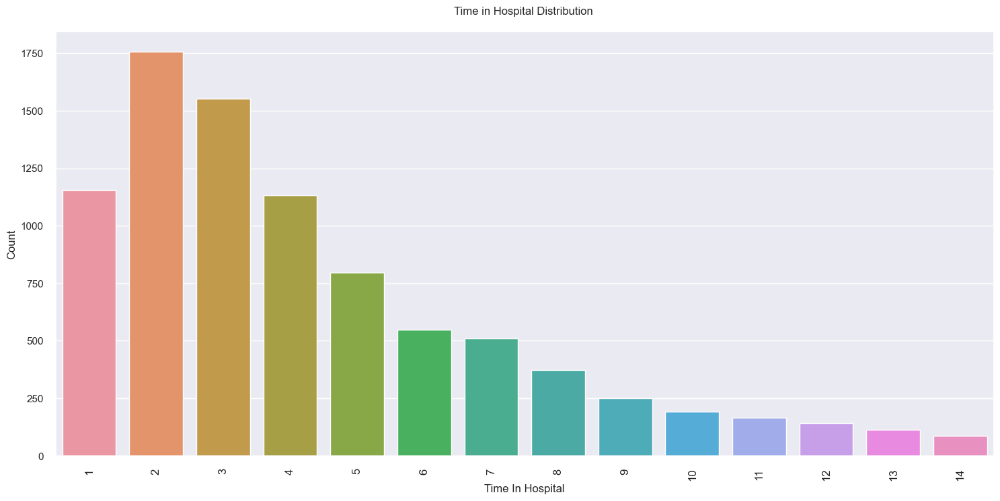

In [19]:
sns.set(rc={'figure.figsize':(18,8.2)})
ax = sns.countplot(x='time_in_hospital',   data= diabetes_diag_df)
plt.xlabel('Time In Hospital', size = 12)
plt.xticks(rotation=90, size = 12)
plt.ylabel('Count', size = 12)
plt.title('Time in Hospital Distribution \n', size = 12)
plt.show()

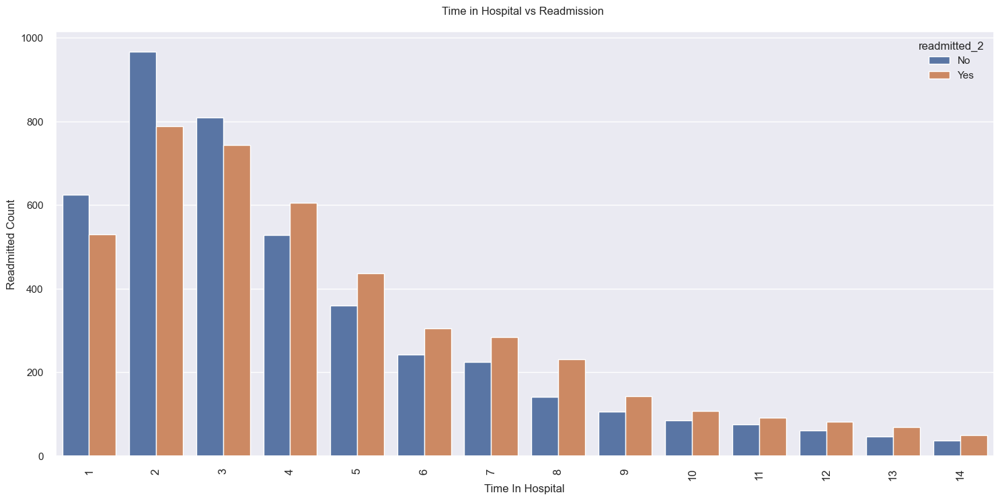

In [20]:
sns.set(rc={'figure.figsize':(18,8.2)})
ax = sns.countplot(x='time_in_hospital',  hue= 'readmitted_2',  data= diabetes_diag_df)
plt.xlabel('Time In Hospital', size = 12)
plt.xticks(rotation=90, size = 12)
plt.ylabel('Readmitted Count', size = 12)
plt.title('Time in Hospital vs Readmission \n', size = 12)
plt.show()

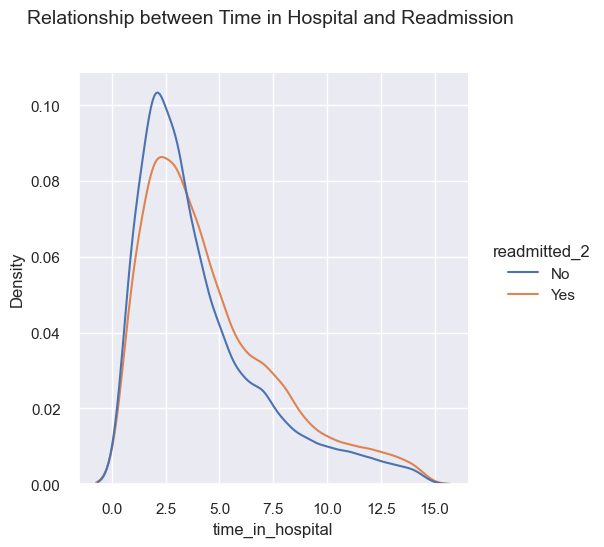

In [21]:
sns.set(rc={'figure.figsize':(18, 8.2)})
sns.displot(diabetes_diag_df, x="time_in_hospital", hue = 'readmitted_2', kind="kde")
plt.title('Relationship between Time in Hospital and Readmission \n\n', size  = 14)
plt.show()

In [22]:
diabetes_diag_df.drop(columns = ['payer_code'], inplace = True)

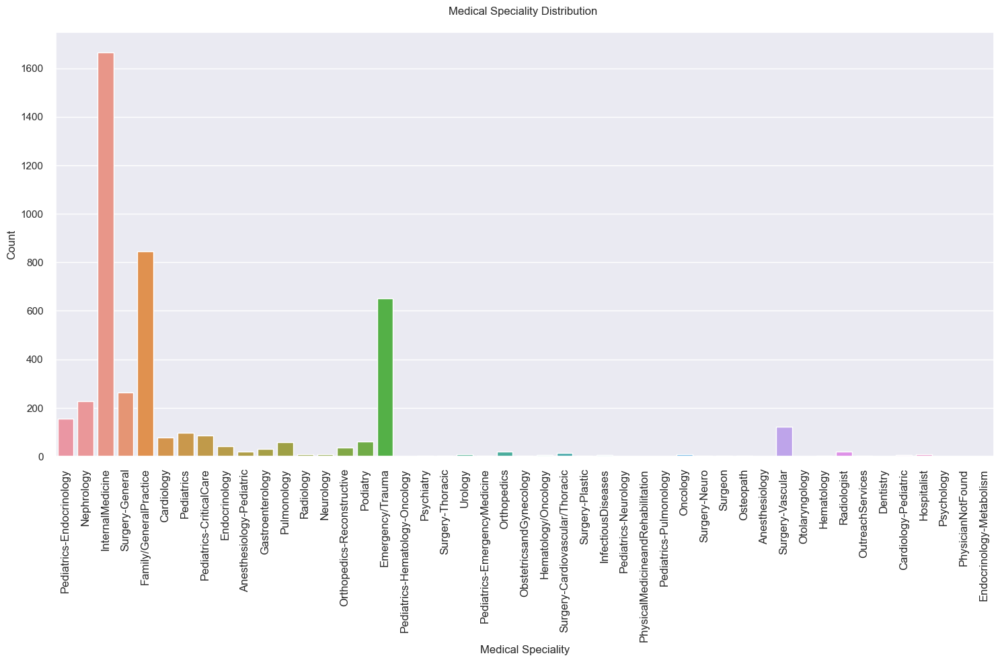

In [23]:
sns.set(rc={'figure.figsize':(18,8.2)})
ax = sns.countplot(x='medical_specialty',   data= diabetes_diag_df)
plt.xlabel('Medical Speciality', size = 12)
plt.xticks(rotation=90, size = 12)
plt.ylabel('Count', size = 12)
plt.title('Medical Speciality Distribution \n', size = 12)
plt.show()

In [24]:
diabetes_diag_df.drop(columns =['medical_specialty'], inplace = True)

In [25]:
diabetes_diag_df.drop(columns = ['acetohexamide', 'tolbutamide', 'troglitazone', 'tolazamide', 'examide', 'citoglipton',
                   'glipizide-metformin', 'glimepiride-pioglitazone', 'metformin-rosiglitazone',
                   'metformin-pioglitazone'], inplace = True)

In [26]:
diabetes_diag_df.shape

(8772, 38)

In [27]:
# Make copy of data.
diabetes_diag_df_ = diabetes_diag_df.copy()

In [28]:
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
le = LabelEncoder()

In [29]:
categorical_features =['race', 'gender', 'age',
       'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'diag_1', 'diag_2', 'diag_3', 'number_diagnoses',
       'max_glu_serum', 'A1Cresult', 'metformin', 'repaglinide', 'nateglinide',
       'chlorpropamide', 'glimepiride', 'glipizide', 'glyburide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'insulin',
       'glyburide-metformin', 'change', 'diabetesMed'] 

for i in categorical_features:
    diabetes_diag_df_[i] = le.fit_transform(diabetes_diag_df_[i])

In [30]:
diabetes_diag_df_.head()

,encounter_id,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,...,pioglitazone,rosiglitazone,acarbose,miglitol,insulin,glyburide-metformin,change,diabetesMed,readmitted,readmitted_2
0,2278392,8222157,2,0,0,5,18,0,1,41,...,1,1,0,0,1,1,1,0,NO,No
1,28236,89869032,0,0,4,0,0,6,9,47,...,1,1,0,0,2,1,1,1,>30,Yes
2,590346,37746639,0,0,4,0,5,6,8,55,...,1,1,0,0,2,1,1,1,>30,Yes
3,630342,93232917,0,0,5,2,5,1,9,37,...,1,1,0,0,2,1,1,1,>30,Yes
4,676422,63754317,0,0,7,0,0,6,4,48,...,1,1,0,0,2,1,1,1,>30,Yes


In [31]:
label = le.fit(diabetes_diag_df_['readmitted_2'])

In [32]:
diabetes_diag_df_['readmitted_2_encoded'] = label.transform(diabetes_diag_df_['readmitted_2'])

In [33]:
diabetes_diag_df_ = diabetes_diag_df_.drop(columns= ['encounter_id', 'patient_nbr', 'readmitted','readmitted_2'])

In [34]:
diabetes_diag_df_

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,glyburide,pioglitazone,rosiglitazone,acarbose,miglitol,insulin,glyburide-metformin,change,diabetesMed,readmitted_2_encoded
0,2,0,0,5,18,0,1,41,0,1,...,1,1,1,0,0,1,1,1,0,0
1,0,0,4,0,0,6,9,47,2,17,...,1,1,1,0,0,2,1,1,1,1
2,0,0,4,0,5,6,8,55,2,17,...,1,1,1,0,0,2,1,1,1,1
3,0,0,5,2,5,1,9,37,2,19,...,1,1,1,0,0,2,1,1,1,1
4,0,0,7,0,0,6,4,48,2,15,...,1,1,1,0,0,2,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8767,2,0,3,0,0,6,5,47,0,31,...,1,1,1,0,0,1,1,1,1,1
8768,2,1,5,0,0,6,4,29,0,16,...,1,1,1,0,0,3,1,0,1,0
8769,2,1,7,1,5,1,4,43,0,10,...,1,1,1,0,0,2,1,0,1,0
8770,4,1,4,0,0,6,13,51,2,13,...,1,1,1,0,0,0,1,0,1,0


In [35]:
# List of columns to keep
columns_to_keep = [
    'readmitted_2_encoded', 'num_lab_procedures', 'num_medications', 'diag_2', 'diag_3', 
    'diag_1', 'time_in_hospital', 'age', 'discharge_disposition_id', 'number_inpatient', 
    'number_diagnoses', 'num_procedures', 'insulin', 'admission_type_id', 
    'admission_source_id', 'race', 'number_outpatient', 'A1Cresult', 'gender', 
    'metformin', 'glipizide', 'glyburide', 'change', 'number_emergency', 'diabetesMed'
]

diabetes_diag_df_ = diabetes_diag_df_[columns_to_keep]

In [36]:
# Check the distribution of 'race' groups
race_distribution = diabetes_diag_df_['race'].value_counts()
print("Race distribution:\n", race_distribution)

Race distribution:
 2    5700
0    2496
3     218
5     190
4     133
1      35
Name: race, dtype: int64


In [37]:
diabetes_diag_df_ = diabetes_diag_df_[diabetes_diag_df_['race'] != 5]

In [38]:
diabetes_diag_df_[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 
   'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']].corr()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
time_in_hospital,1.000000,0.231655,0.492201,0.591973,0.030815,-0.029507,0.052996,0.320818
num_lab_procedures,0.231655,1.000000,0.074318,0.246859,-0.022066,-0.033237,-0.002749,0.065057
num_procedures,0.492201,0.074318,1.000000,0.512839,0.049833,-0.022978,0.012015,0.294910
num_medications,0.591973,0.246859,0.512839,1.000000,0.117495,0.032199,0.122560,0.467998
number_outpatient,0.030815,-0.022066,0.049833,0.117495,1.000000,0.093508,0.122984,0.137827
number_emergency,-0.029507,-0.033237,-0.022978,0.032199,0.093508,1.000000,0.355824,0.084302
number_inpatient,0.052996,-0.002749,0.012015,0.122560,0.122984,0.355824,1.000000,0.102858
number_diagnoses,0.320818,0.065057,0.294910,0.467998,0.137827,0.084302,0.102858,1.000000


In [39]:
diabetes_diag_df_.columns

Index(['readmitted_2_encoded', 'num_lab_procedures', 'num_medications',
       'diag_2', 'diag_3', 'diag_1', 'time_in_hospital', 'age',
       'discharge_disposition_id', 'number_inpatient', 'number_diagnoses',
       'num_procedures', 'insulin', 'admission_type_id', 'admission_source_id',
       'race', 'number_outpatient', 'A1Cresult', 'gender', 'metformin',
       'glipizide', 'glyburide', 'change', 'number_emergency', 'diabetesMed'],
      dtype='object')

In [40]:
# Split the adjusted dataset into training and testing sets
X = diabetes_diag_df_.drop(columns=['readmitted_2_encoded'])
y = diabetes_diag_df_['readmitted_2_encoded']
A = diabetes_diag_df_['race']

X_train, X_test, y_train, y_test, A_train, A_test = train_test_split(
    X, 
    y, 
    A, 
    test_size=0.20, 
    random_state=42)

In [41]:
diabetes_diag_df_

,readmitted_2_encoded,num_lab_procedures,num_medications,diag_2,diag_3,diag_1,time_in_hospital,age,discharge_disposition_id,number_inpatient,...,race,number_outpatient,A1Cresult,gender,metformin,glipizide,glyburide,change,number_emergency,diabetesMed
0,0,41,1,347,404,29,1,0,18,0,...,2,0,2,0,1,1,1,1,0,0
1,1,47,17,129,358,25,9,4,0,0,...,0,0,2,0,1,1,1,1,0,1
2,1,55,17,254,262,24,8,4,5,0,...,0,0,2,0,1,1,1,1,0,1
3,1,37,19,151,144,25,9,5,5,1,...,0,0,2,0,1,1,1,1,0,1
4,1,48,15,338,144,16,4,7,0,0,...,0,0,2,0,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8767,1,47,31,270,274,28,5,3,0,2,...,2,0,1,0,2,1,1,1,0,1
8768,0,29,16,59,69,0,4,5,0,0,...,2,0,2,1,2,1,1,0,0,1
8769,0,43,10,244,346,26,4,7,5,0,...,2,0,1,1,1,3,1,0,0,1
8770,0,51,13,270,294,26,13,4,0,0,...,4,0,2,1,2,1,1,0,0,1


In [42]:
from imblearn.over_sampling import SMOTE  # Import SMOTE
from collections import Counter  # Import Counter from collections module

# Initialize a Counter to count the class distribution before applying SMOTE
counter_before = Counter(y_train)

# Print the class distribution before
print('Before SMOTE:', counter_before)

# Now, let's check the race distribution in the original data
race_counts_original = X_train['race'].value_counts()
print(race_counts_original)

# Initialize SMOTE with a random state
smote = SMOTE(random_state=139)

# Apply SMOTE to oversample
X_train, y_train = smote.fit_resample(X_train, y_train)

# Initialize a Counter to count the class distribution after applying SMOTE
counter_after = Counter(y_train)

# Print the class distribution after
print('After SMOTE:', counter_after)

# Now, let's check the race distribution in the resampled data
race_counts_resampled = X_train['race'].value_counts()
print(race_counts_resampled)


Before SMOTE: Counter({1: 3521, 0: 3344})
2    4550
0    2012
3     169
4     106
1      28
Name: race, dtype: int64
After SMOTE: Counter({1: 3521, 0: 3521})
2    4628
0    2071
3     173
4     106
1      64
Name: race, dtype: int64


In [43]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import plot_confusion_matrix, plot_precision_recall_curve

In [44]:
import xgboost
from sklearn.metrics import classification_report, roc_auc_score

# Train the XGBoost model
xgb = xgboost.XGBClassifier()
xgb.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [45]:
xgb_prediction = xgb.predict(X_test)

In [46]:
print(classification_report(y_test, xgb_prediction, target_names=['Not Readmitted', 'Readmitted']))

# Predict probabilities for the 'Readmitted' class
xgb_probs = xgb.predict_proba(X_test)[:,1]

# Compute and print the ROC-AUC score
auc_score = roc_auc_score(y_test, xgb_probs)
print("AUC Score:", auc_score)

                precision    recall  f1-score   support

Not Readmitted       0.63      0.63      0.63       836
    Readmitted       0.65      0.65      0.65       881

      accuracy                           0.64      1717
     macro avg       0.64      0.64      0.64      1717
  weighted avg       0.64      0.64      0.64      1717

AUC Score: 0.6944173649995384


In [47]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators = 450, max_depth=9, random_state=43)
rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43)

In [48]:
rf_prediction =  rf.predict(X_test)

In [49]:
print(classification_report(y_test, rf_prediction, target_names= ['Not Readmitted', 'Readmitted']))
# Predict probabilities for the 'Readmitted' class
rf_probs = rf.predict_proba(X_test)[:,1]

# Compute and print the ROC-AUC score
auc_score = roc_auc_score(y_test, rf_probs)
print("AUC Score:", auc_score)

                precision    recall  f1-score   support

Not Readmitted       0.67      0.64      0.65       836
    Readmitted       0.67      0.69      0.68       881

      accuracy                           0.67      1717
     macro avg       0.67      0.67      0.67      1717
  weighted avg       0.67      0.67      0.67      1717

AUC Score: 0.7241132575531284


In [50]:
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, roc_auc_score

# Initialize CatBoost classifier
catboost = CatBoostClassifier(iterations=450, random_state=43,verbose=False)

# Train the classifier
catboost.fit(X_train, y_train)

# Make predictions
catboost_prediction = catboost.predict(X_test)

# Print the classification report
print("CatBoost Classifier:")
print(classification_report(y_test, catboost_prediction, target_names=['Not Readmitted', 'Readmitted']))

# Predict probabilities for the 'Readmitted' class
catboost_probs = catboost.predict_proba(X_test)[:, 1]

# Compute and print the ROC-AUC score
auc_score = roc_auc_score(y_test, catboost_probs)
print("AUC Score:", auc_score)


CatBoost Classifier:
                precision    recall  f1-score   support

Not Readmitted       0.67      0.64      0.66       836
    Readmitted       0.67      0.70      0.69       881

      accuracy                           0.67      1717
     macro avg       0.67      0.67      0.67      1717
  weighted avg       0.67      0.67      0.67      1717

AUC Score: 0.7162152621260094


In [51]:
# set up model:
classifiers = [catboost,
               rf,
               xgb]

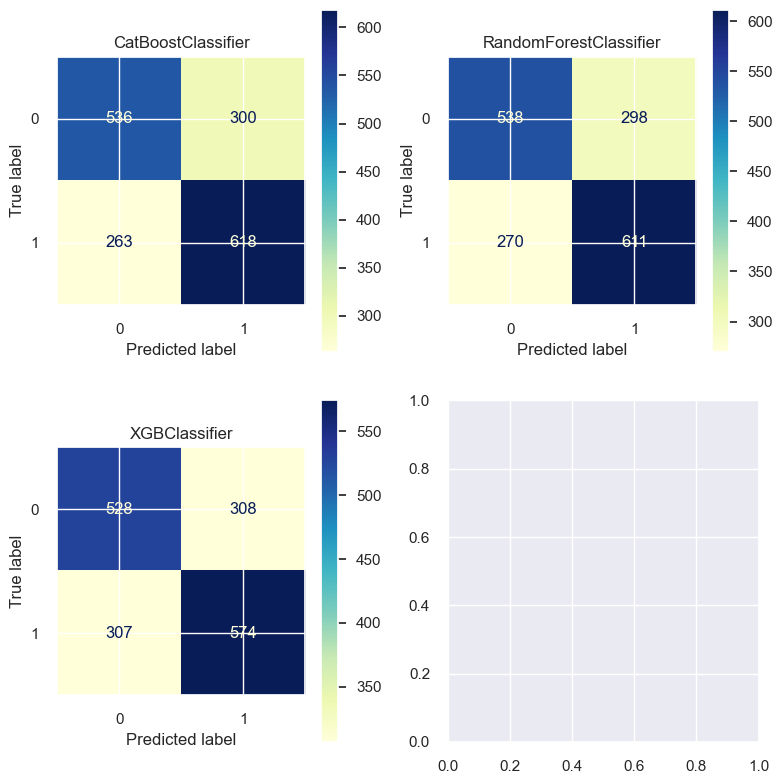

In [52]:
# test set
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 8))

for cls, ax in zip(classifiers, axes.flatten()):
    cls.fit(X_train, y_train)
    plot_confusion_matrix(cls, 
                          X_test, 
                          y_test, 
                          ax=ax, 
                          cmap='YlGnBu')
    ax.title.set_text(type(cls).__name__)
plt.tight_layout()
plt.show()

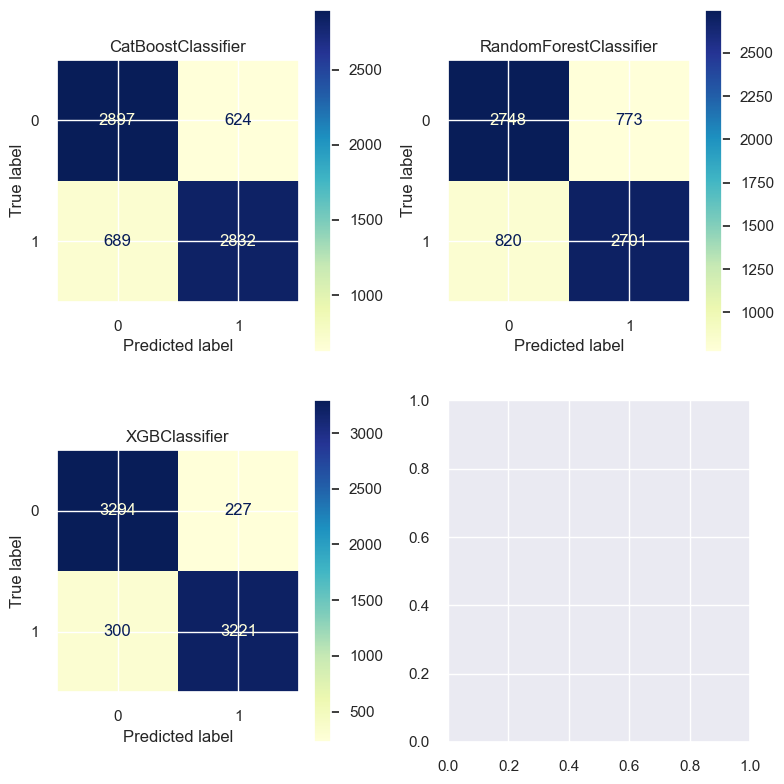

In [53]:
# double check with train set
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 8))

for cls, ax in zip(classifiers, axes.flatten()):
    cls.fit(X_train, y_train)
    plot_confusion_matrix(cls, 
                          X_train, 
                          y_train, 
                          
                          ax=ax, 
                          cmap='YlGnBu')
    ax.title.set_text(type(cls).__name__)
plt.tight_layout()
plt.show()

In [54]:
for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)
  print(f'{model}: {chr(10)} {classification_report(y_test, y_pred)}') 

<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
               precision    recall  f1-score   support

           0       0.67      0.64      0.66       836
           1       0.67      0.70      0.69       881

    accuracy                           0.67      1717
   macro avg       0.67      0.67      0.67      1717
weighted avg       0.67      0.67      0.67      1717

RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43): 
               precision    recall  f1-score   support

           0       0.67      0.64      0.65       836
           1       0.67      0.69      0.68       881

    accuracy                           0.67      1717
   macro avg       0.67      0.67      0.67      1717
weighted avg       0.67      0.67      0.67      1717

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
     

In [55]:
from sklearn.model_selection import cross_val_predict, StratifiedKFold
from sklearn.metrics import classification_report, roc_auc_score



classifier_names = ["CatBoostClassifier", "RandomForestClassifier", "XGBoostClassifier"]

# Define the number of splits for cross-validation
n_splits = 4

# Loop over classifiers
for model, classifier_name in zip(classifiers, classifier_names):
    print(f"Evaluating {classifier_name}:")
    
    # Initialize lists to store classification reports and AUC scores
    classification_reports = []
    auc_scores = []
    
    # Perform cross-validation
    for train_index, test_index in StratifiedKFold(n_splits=n_splits).split(X_test, y_test):
        X_train_cv, X_test_cv = X_test.iloc[train_index], X_test.iloc[test_index]
        y_train_cv, y_test_cv = y_test.iloc[train_index], y_test.iloc[test_index]

        # Fit the model on the training data
        model.fit(X_train_cv, y_train_cv)

        # Make predictions on the test data
        y_pred_cv = model.predict(X_test_cv)

        # Predict probabilities for the 'Readmitted' class
        y_probs_cv = model.predict_proba(X_test_cv)[:, 1]

        # Compute the ROC-AUC score
        auc_cv = roc_auc_score(y_test_cv, y_probs_cv)
        auc_scores.append(auc_cv)

        # Generate and store the classification report
        report_cv = classification_report(y_test_cv, y_pred_cv, target_names=['Not Readmitted', 'Readmitted'], output_dict=True)
        classification_reports.append(report_cv)

    # Calculate the average AUC score across cross-validation folds
    avg_auc_score = sum(auc_scores) / len(auc_scores)
    
    # Calculate the average classification report across cross-validation folds
    avg_classification_report = {}
    for label in ['Not Readmitted', 'Readmitted']:
        avg_classification_report[label] = {
            'precision': sum(report[label]['precision'] for report in classification_reports) / len(classification_reports),
            'recall': sum(report[label]['recall'] for report in classification_reports) / len(classification_reports),
            'f1-score': sum(report[label]['f1-score'] for report in classification_reports) / len(classification_reports),
            'support': int(sum(report[label]['support'] for report in classification_reports) / len(classification_reports))
        }

    # Format and print the results
    print("Average Classification Report Aware of Race:")
    for label in avg_classification_report:
        print(f"{label}:")
        for metric in avg_classification_report[label]:
            print(f"{metric}: {avg_classification_report[label][metric]:.2f}")
        print()
    print(f"Average AUC Score: {avg_auc_score:.2f}")
    print("\n")

Evaluating CatBoostClassifier:
Average Classification Report Aware of Race:
Not Readmitted:
precision: 0.63
recall: 0.61
f1-score: 0.62
support: 209.00

Readmitted:
precision: 0.64
recall: 0.65
f1-score: 0.65
support: 220.00

Average AUC Score: 0.70


Evaluating RandomForestClassifier:
Average Classification Report Aware of Race:
Not Readmitted:
precision: 0.63
recall: 0.61
f1-score: 0.62
support: 209.00

Readmitted:
precision: 0.64
recall: 0.67
f1-score: 0.65
support: 220.00

Average AUC Score: 0.71


Evaluating XGBoostClassifier:
Average Classification Report Aware of Race:
Not Readmitted:
precision: 0.59
recall: 0.58
f1-score: 0.59
support: 209.00

Readmitted:
precision: 0.61
recall: 0.63
f1-score: 0.62
support: 220.00

Average AUC Score: 0.66




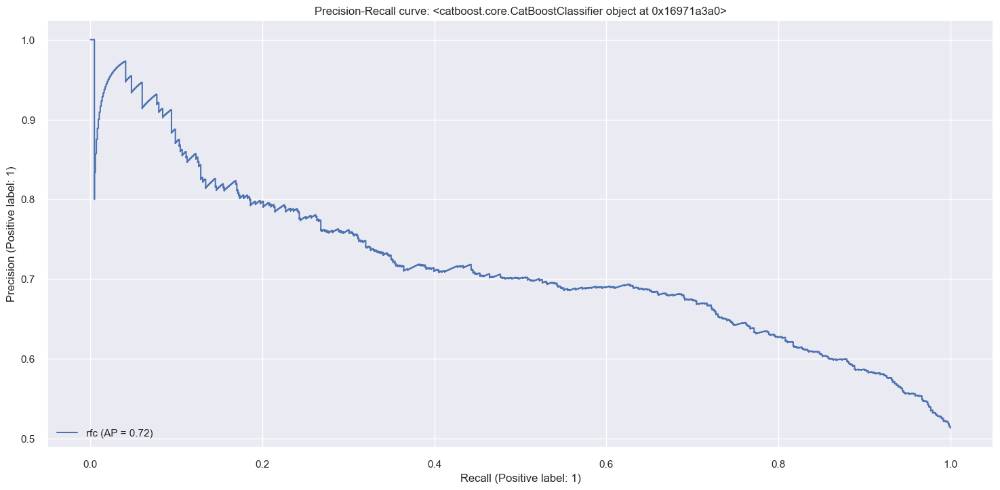

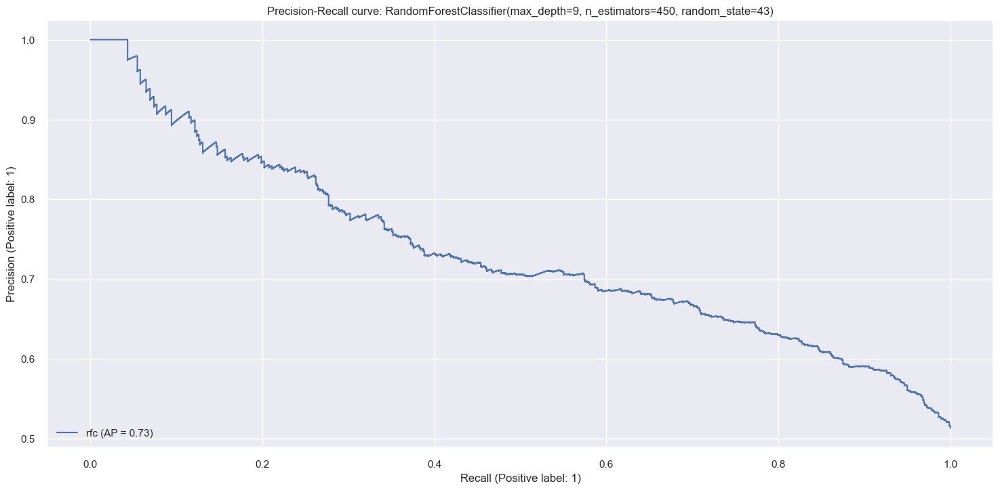

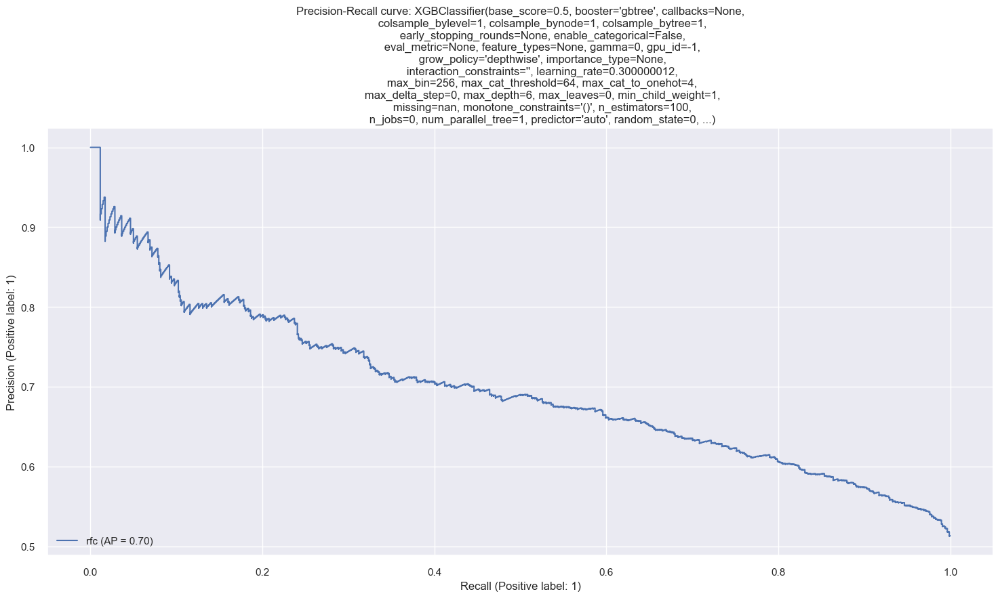

In [56]:
for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)
  display = PrecisionRecallDisplay.from_estimator(model, X_test, y_test, name="rfc")
  _ = display.ax_.set_title(f'Precision-Recall curve: {model}')   

In [57]:
# define sensitive attributes
race =  A_test


for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # scores on test set
  y_pred = model.predict_proba(X_test)[:, 1]

  # predictions (0 or 1) on test set
  test_preds = (y_pred >= np.mean(y_train)) * 1

  print(f'Race:{chr(10)}{model}: {chr(10)} {metric_frame (race)} {chr(10)}')

Race:
<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
            FPR       FNR       TPR       TNR
race                                        
0     0.250000  0.377193  0.622807  0.750000
1     0.333333  0.000000  1.000000  0.666667
2     0.410112  0.269481  0.730519  0.589888
3     0.321429  0.238095  0.761905  0.678571
4     0.500000  0.400000  0.600000  0.500000 

Race:
RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43): 
            FPR       FNR       TPR       TNR
race                                        
0     0.257812  0.394737  0.605263  0.742188
1     0.333333  0.000000  1.000000  0.666667
2     0.400749  0.275974  0.724026  0.599251
3     0.321429  0.190476  0.809524  0.678571
4     0.583333  0.400000  0.600000  0.416667 

Race:
XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
       

In [58]:
# Define sensitive attributes
race = A_test

# Initialize lists to store the differences
difference_race1_and_2 = []
difference_race3_and_2 = []

# Metrics 
for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # scores on test set
    y_pred = model.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    test_preds = (y_pred >= np.mean(y_train)) * 1

    models_dict = {"Aware-Unmitigated": (test_preds, y_pred)}

    # Calculate the TPR for each race group
    tpr_race1 = metric_frame(race)["TPR"][1]  # TPR for race 1
    tpr_race2 = metric_frame(race)["TPR"][2]  # TPR for race 2
    tpr_race3 = metric_frame(race)["TPR"][3]  # TPR for race 5

    # Calculate and store the differences
    diff1_and_2 = tpr_race2 - tpr_race1
    diff3_and_2 = tpr_race2 - tpr_race3

    difference_race1_and_2.append(diff1_and_2)
    difference_race3_and_2.append(diff3_and_2)

    print(f'Race:{chr(10)}{model}: {chr(10)} {get_metrics_df(models_dict, y_test, race)} {chr(10)}') 

    # Calculate Equal Opportunity Differences for the current classifier
    eod_race1_and_2 = diff1_and_2
    eod_race3_and_2 = diff3_and_2

    print(f'Equal Opportunity Difference between Races Asian and Caucasian: {eod_race1_and_2}')
    print(f'Equal Opportunity Difference between Races Hispanic and Caucasian: {eod_race3_and_2}')

# Calculate the overall Equal Opportunity Differences between races 1 and 2 and between races 3 and 2
eod_race1_and_2_avg = sum(difference_race1_and_2) / len(difference_race1_and_2)
eod_race3_and_2_avg = sum(difference_race3_and_2) / len(difference_race3_and_2)

# Print the average Equal Opportunity Differences
print(f'Average Equal Opportunity Difference between Races Asian and Caucasian: {eod_race1_and_2_avg}')
print(f'Average Equal Opportunity Difference between Races Hispanic and Caucasian: {eod_race3_and_2_avg}')



Race:
<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
                                Aware-Unmitigated
Equalized_odds_difference                    0.4
False negative rate difference               0.4
Balanced error rate difference          0.283333
Demographic parity difference           0.156119
  ------                                        
Overall AUC                             0.716215
AUC difference                          0.372222 

Equal Opportunity Difference between Races Asian and Caucasian: -0.26948051948051943
Equal Opportunity Difference between Races Hispanic and Caucasian: -0.031385281385281294
Race:
RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43): 
                                Aware-Unmitigated
Equalized_odds_difference                    0.4
False negative rate difference               0.4
Balanced error rate difference             0.325
Demographic parity difference           0.171105
  ------                                 

## In terms of fairness and bias:

If both curves follow a similar shape and are close to each other, it suggests that the model's predictions are relatively fair across these groups — the likelihood of being predicted for readmission increases at a similar rate for both groups as the prediction scores increase.
A large disparity between the curves, especially at important decision thresholds (such as the median probability score used for classifying a patient as readmitted or not), could indicate potential bias. The model might be more likely to predict one group as needing readmission over another, despite similar true likelihoods.
The point of maximum disparity provides a specific threshold where the difference in predictions between the two groups is greatest. This can be a point of interest for investigating potential bias in the model's predictions.
For your case, where fairness and equity among race groups are crucial, especially ensuring that the Asian race group is not unfairly denied readmissions, you would prefer the disparity between the curves to be minimal across all probability thresholds. This would mean that both groups have an equal chance of being flagged for readmission based on their predicted probabilities, reducing the risk of discriminatory outcomes based on race.

## EXPLAIN CLASSIFIERS OUTPUT WITH THE 20 TOP FEATURES ONLY

In [61]:
import dalex as dx
from sklearn.pipeline import Pipeline


In [62]:
clf = Pipeline(steps=[
    ('classifier', xgb)
])

clf.fit(X, y)

Pipeline(steps=[('classifier',
                 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=0, gpu_id=-1,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constraints='',
                               learning_rate=0.300000012, max_bin=256,
                               max_cat_threshold=64, max_cat_to_onehot=4,
                               max_delta_step=0, max_depth=6, max_leaves=0,
                               min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=100,
                               n_jobs=0, num_parallel_tree=1, predictor='auto',
                               random_state=0, ...))])

In [63]:
exp = dx.Explainer(clf, X, y)


Preparation of a new explainer is initiated

  -> data              : 8582 rows 24 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 8582 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x169da7af0> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.00188, mean = 0.513, max = 0.999
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.876, mean = 5.16e-05, max = 0.921
  -> model_info        : package sklearn

A new explainer has been created!


In [64]:
exp.model_performance().result


,recall,precision,f1,accuracy,auc
XGBClassifier,0.899364,0.89631,0.897834,0.895013,0.963906


In [65]:
# Create a 'protected' array-like based on the 'race' column
protected = np.where(diabetes_diag_df_['race'] == 1, 'protected', np.where(diabetes_diag_df_['race'] == 2, 'privileged', 'other'))
privileged = 'privileged'

In [66]:
fobject = exp.model_fairness(protected = protected, privileged=privileged)


In [67]:
fobject.fairness_check(epsilon = 0.8) # default epsilon


Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded acceptable limits set by epsilon.

Ratios of metrics, based on 'privileged'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
                TPR       ACC       PPV       FPR       STP
other      0.957190  1.013468  1.032658  0.526316  0.816029
protected  1.006586  1.089787  1.126126       NaN  0.571949

Warning!
Take into consideration that NaN's are present, consider checking 'metric_scores' plot to see the difference


In [68]:
# to see all scaled metric values you can run
fobject.result

,TPR,TNR,PPV,NPV,FNR,FPR,FDR,FOR,ACC,STP
other,0.957190,1.072664,1.032658,0.995531,1.438202,0.526316,0.741071,1.038095,1.013468,0.816029
privileged,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
protected,1.006586,1.153403,1.126126,1.070391,0.932584,NaN,NaN,0.400000,1.089787,0.571949


In [69]:
# or unscaled ones via
fobject.metric_scores

,TPR,TNR,PPV,NPV,FNR,FPR,FDR,FOR,ACC,STP
other,0.872,0.930,0.917,0.891,0.128,0.070,0.083,0.109,0.903,0.448
privileged,0.911,0.867,0.888,0.895,0.089,0.133,0.112,0.105,0.891,0.549
protected,0.917,1.000,1.000,0.958,0.083,0.000,0.000,0.042,0.971,0.314


In [70]:
fobject.plot()


Equal Opportunity Ratio: This metric looks at the ratio of true positives rates (TPR) between different groups. The XGBClassifier seems to be fair across the protected groups, as the bars are close to 1, which indicates similar TPRs.

Predictive Parity Ratio: This ratio examines the balance of positive predictive values (PPV), which is the proportion of positive identifications that were actually correct. Your results show that the PPV is well balanced across groups since the bars are near 1, suggesting that when the model predicts a positive outcome, it is correct at a similar rate across groups.

Predictive Equality Ratio: This focuses on the false positive rates (FPR) across groups. The bars are again close to 1, indicating that the model's FPR is consistent across different groups, meaning it is not more likely to falsely predict a positive outcome for one group over another.

Accuracy Equality Ratio: This checks if the accuracy of the model (the proportion of true results among the total number of cases examined) is similar across groups. Your model appears to have uniform accuracy across the protected groups, as the bars are aligned near the 1 mark.

Statistical Parity Ratio: This is the ratio of the rate at which each group receives a positive outcome. The bars are on the 1 line, suggesting that each group has an equal likelihood of receiving a positive outcome from the model.

In [71]:
fobject.plot(type = 'metric_scores')


Vertical lines showcase the score of the privileged subgroup. Points closer to the line indicate less bias in the model.

Both plot types are complementary in terms of the metrics. Metric Scores plot is an excellent way to ensure that the interpretation of the Fairness Check plot is on point (small metric values may make the ratios high/low).

In [72]:
from sklearn.pipeline import Pipeline
# Assuming catboost, xgb, and rf are your model objects and they are already imported or defined.

# Create pipelines for each classifier
clf_catboost = Pipeline(steps=[('classifier', catboost)])
clf_xgb = Pipeline(steps=[('classifier', xgb)])
clf_rf = Pipeline(steps=[('classifier', rf)])

# Now fit the pipelines separately
clf_catboost.fit(X, y)
clf_xgb.fit(X, y)
clf_rf.fit(X, y)



Pipeline(steps=[('classifier',
                 RandomForestClassifier(max_depth=9, n_estimators=450,
                                        random_state=43))])

In [73]:
# create Explainer objects 
exp_catboost  = dx.Explainer(clf_catboost, X,y, verbose = False)
exp_rf  = dx.Explainer(clf_rf, X,y, verbose = False)

# create fairness explanations
fobject_catboost = exp_catboost.model_fairness(protected, privileged)
fobject_rf = exp_rf.model_fairness(protected, privileged)

In [74]:
fobject.plot(objects=[fobject_catboost, fobject_rf])

### XGB is the most biased model for these particular Metrics for the protected group

In [75]:
fobject.plot(objects=[fobject_catboost, fobject_rf], type = "metric_scores")

In [76]:
# attribute of object
fobject.parity_loss

TPR    0.050318
TNR    0.212862
PPV    0.150919
NPV    0.072503
FNR    0.433190
FPR         NaN
FDR         NaN
FOR    0.953678
ACC    0.099360
STP    0.762011
dtype: float64

Parity loss apart from being an attribute is a way that summarizes the bias across subgroups. We needed a function that is symmetrical in terms of division (f(a/b) = f(b/a)). This is why we decided to use following formula:parityloss

The intuition behind this formula is simple. The bigger the difference in metrics the higher the parity loss will be. It is good entry point for visualization because we have only one value for each metric.

With this knowledge we are now ready for some plots! Note that in all following plots the metrics can be changed. Just pass metrics = ["TPR", "FPR", ... ]

## Radar plot

Fairly simple radar plot, it shows each parity loss of metric in form of point on ploar coordinate system.



In [77]:
fobject.plot(objects=[fobject_catboost, fobject_rf], type = "radar")

Found NaNs in following models: {'XGBClassifier'}


## Heatmap is also simple way to check parity loss.

In [78]:
fobject.plot(objects=[fobject_catboost, fobject_rf], type = "heatmap")


Found NaNs in following models: {'XGBClassifier'}


## Stacks
Stacked plot is a way to look at cumulated parity loss. It stacks each bar on top of each other. The widths of bars depict the amount of bias. The lesser the better.



In [79]:
fobject.plot(objects=[fobject_catboost, fobject_rf], type = "stacked")


Found NaNs in following models: {'XGBClassifier'}


## Performance and Fairness
Sometime it is good idea to look both at performance and fairness metrics. This is where this plot is handy! This plot does not have metrics parameter, but it requires fairness_metric and performance_metric parameters. The dafaults are TPR and accuracy respectively.

In [80]:
fobject.plot(objects=[fobject_catboost, fobject_rf], type = "performance_and_fairness")


## Variable Importance - Shap - Anchors


In [81]:
from dalex.fairness import resample, reweight, roc_pivot
from copy import copy

In [83]:
import shap

# Summarize the background data with fewer samples using shap.sample
background_data_summary = shap.sample(X_train, 1000)

# Initialize the KernelExplainer with the summarized background data
explainer = shap.KernelExplainer(rf.predict_proba, background_data_summary)


# Calculate SHAP values for a specific instance
instance_idx = 0  # Replace with the index of the instance you want to explain
shap_values = explainer.shap_values(X_test.iloc[instance_idx, :])

# Plot the SHAP values
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test.iloc[instance_idx, :])


Using 1000 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [84]:
vi = exp_rf.model_parts()
vi.result

,variable,dropout_loss,label
0,_full_model_,0.160715,RandomForestClassifier
1,glyburide,0.162872,RandomForestClassifier
2,glipizide,0.163265,RandomForestClassifier
3,diabetesMed,0.163357,RandomForestClassifier
4,change,0.165730,RandomForestClassifier
5,metformin,0.169088,RandomForestClassifier
6,admission_source_id,0.169375,RandomForestClassifier
7,insulin,0.169720,RandomForestClassifier
8,race,0.170507,RandomForestClassifier
9,gender,0.170624,RandomForestClassifier


In [85]:
vi.plot(max_vars=30)


In [86]:
import lime
import lime.lime_tabular

In [87]:
# LIME has one explainer for all the models
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns.values.tolist(),
                                                  class_names=['MEDV'], verbose=True, mode='regression')

In [88]:
j = 1000
exp = explainer.explain_instance(X_test.values[j], rf.predict, num_features=15)

Intercept 0.9422849994211009
Prediction_local [0.93283145]
Right: 1


### Random Instance - Caucasian Race - Race 2 affects positively the Y output of Random Forest 

In [89]:
# Show the predictions
exp.show_in_notebook(show_table=True)

In [90]:
exp.as_list()


[('0.00 < number_inpatient <= 1.00', 0.49978247412985943),
 ('number_emergency <= 0.00', -0.4540966581187727),
 ('number_outpatient <= 0.00', -0.24267869105771983),
 ('0.00 < gender <= 1.00', -0.06803617613181481),
 ('0.00 < race <= 2.00', 0.05677171933195661),
 ('metformin <= 1.00', 0.054107955842330885),
 ('1.00 < A1Cresult <= 2.00', 0.045495806312981654),
 ('161.00 < diag_2 <= 254.00', 0.04523599791849943),
 ('13.00 < num_medications <= 18.00', 0.043711843845697276),
 ('194.00 < diag_3 <= 279.00', 0.03418583395887816),
 ('admission_type_id <= 0.00', -0.032719389121155684),
 ('0.00 < change <= 1.00', 0.029205918928091858),
 ('glyburide > 1.00', 0.026756664213414896),
 ('num_procedures <= 0.00', -0.024000520427722213),
 ('34.00 < num_lab_procedures <= 46.00', -0.023176328100010014)]

In [91]:
exp_lime_xgb = explainer.explain_instance(X_test.values[j], xgb.predict, num_features=15)

Intercept 0.5219936755644844
Prediction_local [0.78705177]
Right: 1


### Random Instance - Caucasian Race - Race affects positively the Y output of XGBoost 

In [92]:
# Show the predictions
exp_lime_xgb.show_in_notebook(show_table=True)

In [93]:
exp_lime_xgb.as_list()

[('number_emergency <= 0.00', -0.24632535668220673),
 ('0.00 < number_inpatient <= 1.00', 0.15013966690988043),
 ('discharge_disposition_id <= 0.00', 0.14338277955187065),
 ('0.00 < gender <= 1.00', -0.08869055258147374),
 ('admission_type_id <= 0.00', -0.08727636352672596),
 ('4.00 < number_diagnoses <= 6.00', 0.08397957365048281),
 ('metformin <= 1.00', 0.06860394326110693),
 ('insulin <= 1.00', 0.06323961652587597),
 ('glyburide > 1.00', 0.06158602275438553),
 ('161.00 < diag_2 <= 254.00', 0.05913978391694442),
 ('13.00 < num_medications <= 18.00', 0.05841715274987386),
 ('0.00 < race <= 2.00', 0.05451823081399475),
 ('number_outpatient <= 0.00', -0.04875804742773696),
 ('num_procedures <= 0.00', -0.04707817766448819),
 ('1.00 < A1Cresult <= 2.00', 0.04017982461583955)]

#### Focus on Asian Race, explain instances with SHAP - RandomForest

In [94]:
# Get the indices of the test set where race is 1
indices_of_race_1 = X_test[X_test['race'] == 1].index.tolist()

# Loop through the indices of race 1 and explain the predictions
for idx in indices_of_race_1[:5]:  # Adjust the number as needed
    # Get the local index in X_test
    local_index = X_test.index.get_loc(idx)
    
    # Explain the prediction for the instance at local_index
    exp = explainer.explain_instance(X_test.values[local_index], rf.predict_proba, num_features=15)
    exp.show_in_notebook(show_table=True)
    print(f"Instance {idx} explanation:")



Intercept 0.22800152424101788
Prediction_local [0.61754533]
Right: 0.6789167350096204


Instance 7214 explanation:
Intercept 0.23092996677851574
Prediction_local [0.64799969]
Right: 0.7238930413322306


Instance 7531 explanation:
Intercept 0.23156956437647136
Prediction_local [0.60919662]
Right: 0.7265641434850345


Instance 767 explanation:
Intercept 0.47964908915932564
Prediction_local [0.30008869]
Right: 0.4906816350063223


Instance 2829 explanation:
Intercept 0.4757426246261297
Prediction_local [0.32451574]
Right: 0.34281126460182515


Instance 8211 explanation:


#### Focus on Asian Race, explain instances with SHAP - XGBoost (the most biased model)


In [95]:
# Get the indices of the test set where race is 1
indices_of_race_1 = X_test[X_test['race'] == 2].index.tolist()

# Loop through the indices of race 1 and explain the predictions
for idx in indices_of_race_1[:5]:  # Adjust the number as needed
    # Get the local index in X_test
    local_index = X_test.index.get_loc(idx)
    
    # Explain the prediction for the instance at local_index
    exp = explainer.explain_instance(X_test.values[local_index], xgb.predict_proba, num_features=15)
    exp.show_in_notebook(show_table=True)
    print(f"Instance {idx} explanation:")

Intercept 0.43611696701187747
Prediction_local [0.24783827]
Right: 0.1131466


Instance 4947 explanation:
Intercept 0.25563534412332867
Prediction_local [0.59546625]
Right: 0.98344964


Instance 6889 explanation:
Intercept 0.6583454031918766
Prediction_local [0.28407716]
Right: 0.68232065


Instance 225 explanation:
Intercept 0.3685792238296986
Prediction_local [0.45815586]
Right: 0.4780569


Instance 6981 explanation:
Intercept 0.23774857931834942
Prediction_local [0.74000308]
Right: 0.996064


Instance 1097 explanation:


In [99]:
import shap
import matplotlib.pyplot as plt

# Load JS visualization code to the notebook
shap.initjs()

# Create the explainer
explainer = shap.TreeExplainer(rf)

shap_values = explainer.shap_values(X_test)

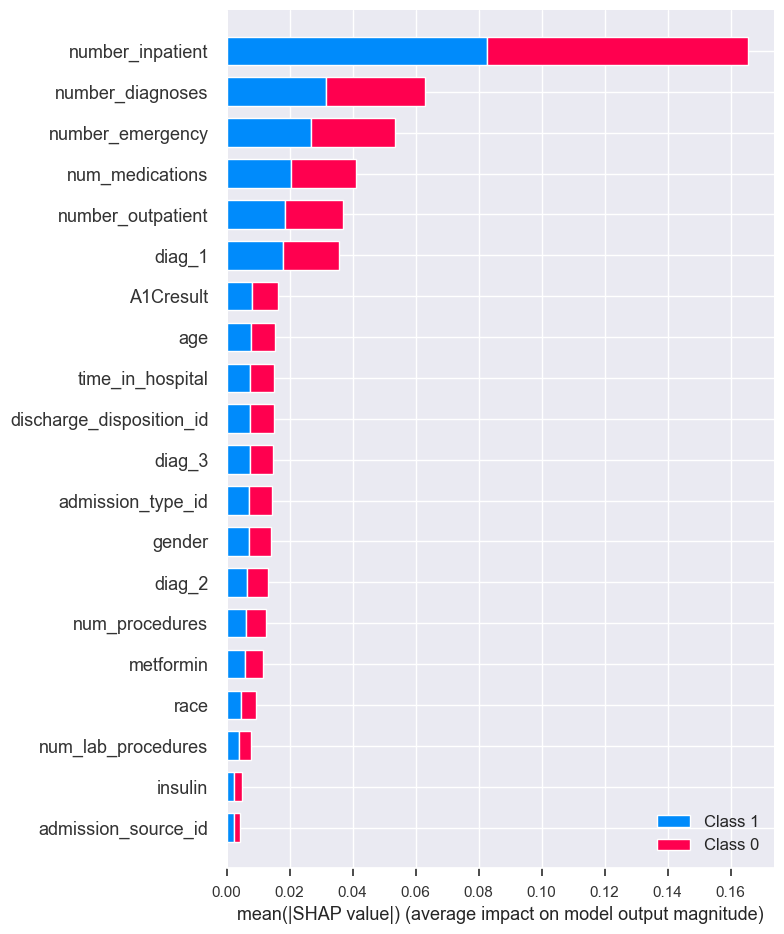

In [100]:
# Create a summary plot and set the feature names
shap.summary_plot(shap_values, X_test, show=False)

# Display the plot
plt.show()

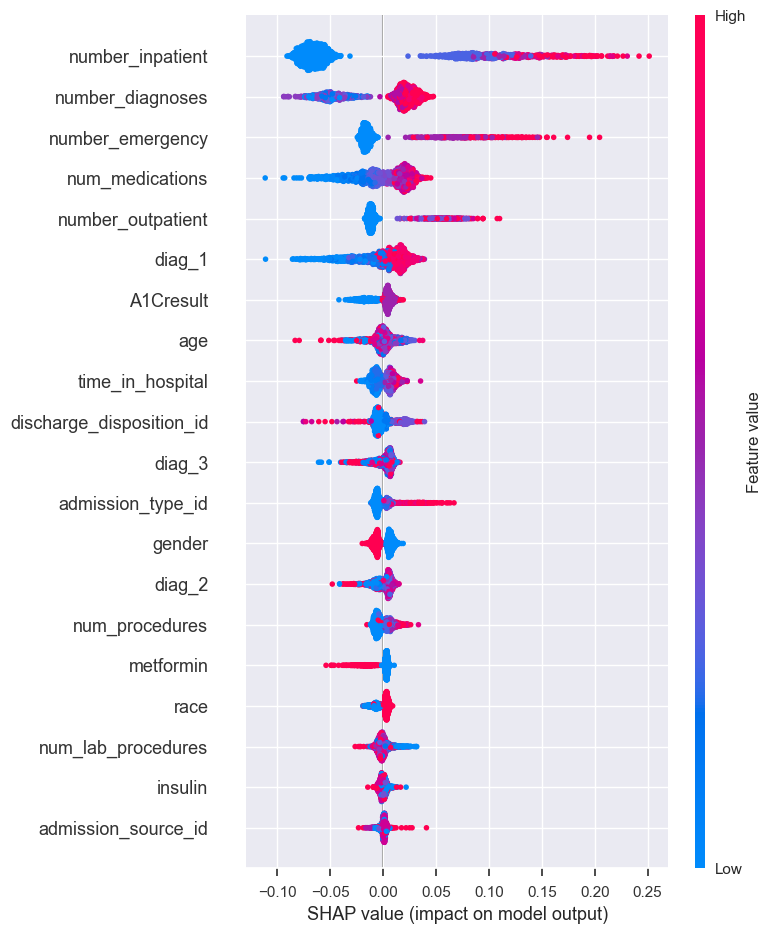

In [101]:
shap.summary_plot(shap_values[1], X_test)

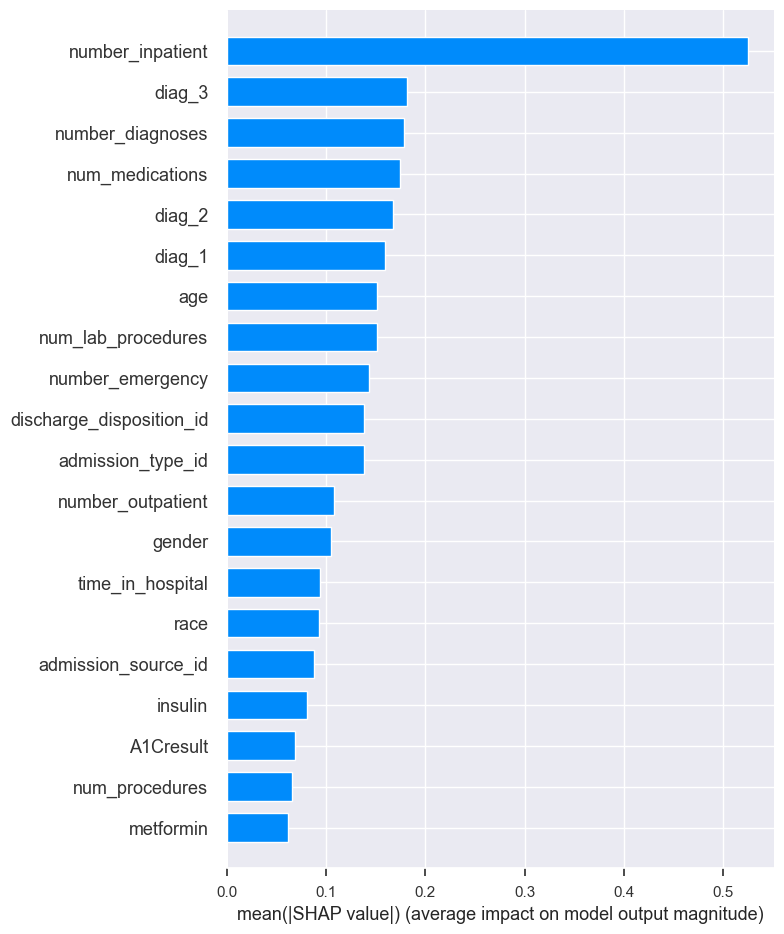

In [102]:
import shap


# Initialize the SHAP explainer with the model and training data
explainer = shap.TreeExplainer(xgb)
shap_values = explainer.shap_values(X_train)

# Summarize the SHAP values across the dataset for global feature importance
shap.summary_plot(shap_values, X_train, plot_type="bar")


### Top weights for each classifier, affecting the output

In [104]:
import eli5
eli5.show_weights(xgb, feature_names=X_train.columns.tolist())


Weight,Feature
0.1800,number_inpatient
0.0547,number_diagnoses
0.0546,number_emergency
0.0448,discharge_disposition_id
0.0405,number_outpatient
0.0379,age
0.0377,admission_type_id
0.0368,metformin
0.0368,diag_1
0.0366,diabetesMed


In [105]:
import eli5
eli5.show_weights(rf, feature_names=X_train.columns.tolist())


Weight,Feature
0.2080 ± 0.1367,number_inpatient
0.0759 ± 0.0560,num_medications
0.0716 ± 0.0767,number_diagnoses
0.0676 ± 0.0474,diag_1
0.0649 ± 0.0744,number_emergency
0.0597 ± 0.0386,diag_3
0.0553 ± 0.0293,num_lab_procedures
0.0514 ± 0.0322,diag_2
0.0498 ± 0.0351,age
0.0439 ± 0.0541,number_outpatient


In [106]:
import eli5
eli5.show_weights(catboost, feature_names=X_train.columns.tolist())


Weight,Feature
0.0961,number_inpatient
0.0905,discharge_disposition_id
0.0838,diag_3
0.0755,diag_1
0.0736,num_lab_procedures
0.0704,num_medications
0.0662,age
0.0640,diag_2
0.0437,number_diagnoses
0.0430,time_in_hospital


In [108]:
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show

# Train an Explainable Boosting Classifier
ebm = ExplainableBoostingClassifier()
ebm.fit(X_train, y_train)

# Explain the model
ebm_global = ebm.explain_global()
ebm_local = ebm.explain_local(X_test, y_test)

# Visualize the explanations
show(ebm_global)
show(ebm_local)


<!-- http://127.0.0.1:7001/6222664416/ -->

<!-- http://127.0.0.1:7001/12069322560/ -->

### Reweighting on top 20 features only 

In [110]:
import aif360

from aif360.datasets import StandardDataset
from sklearn.pipeline import make_pipeline 
from sklearn.pipeline import Pipeline

# Fairness metrics
from aif360.metrics import BinaryLabelDatasetMetric
from aif360.metrics import DatasetMetric

from aif360.metrics import ClassificationMetric

# Explainers
from aif360.explainers import MetricTextExplainer

# Scalers
from sklearn.preprocessing import StandardScaler

# Bias mitigation techniques
from aif360.algorithms.preprocessing import Reweighing
from aif360.algorithms.inprocessing import AdversarialDebiasing
from aif360.algorithms.inprocessing import PrejudiceRemover

# fairlearn libraries
from fairlearn.postprocessing import ThresholdOptimizer, plot_threshold_optimizer
from fairlearn.postprocessing._interpolated_thresholder import InterpolatedThresholder
from fairlearn.postprocessing._threshold_operation import ThresholdOperation

from fairlearn.reductions import (ExponentiatedGradient, 
                                  EqualizedOdds, 
                                  ErrorRateParity)

pip install 'aif360[LawSchoolGPA]'


In [111]:


# libraries for models
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# libraries for data processing
from sklearn import preprocessing
from sklearn.model_selection import train_test_split

# libraries for metrics of models
from sklearn.metrics import (
    accuracy_score, confusion_matrix,
    roc_curve, auc, roc_auc_score,
    plot_confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    PrecisionRecallDisplay)

from sklearn.model_selection import GroupKFold
from sklearn.model_selection import cross_val_score

# libraries for fairness
from fairlearn.metrics import MetricFrame
from fairlearn.postprocessing import ThresholdOptimizer


from fairlearn.metrics import (
    MetricFrame,
    selection_rate, 
    demographic_parity_difference, 
    demographic_parity_ratio,
    false_positive_rate, 
    false_negative_rate,
    false_positive_rate_difference, 
    false_negative_rate_difference, 
    true_positive_rate, 
    true_negative_rate,
    selection_rate,
    count,
    equalized_odds_difference)
     



In [112]:
ds_aif = aif360.datasets.StandardDataset (diabetes_diag_df_, 
                                         label_name="readmitted_2_encoded",
                                         favorable_classes = [1], 
                                         protected_attribute_names=['race'], 
                                         privileged_classes= [lambda x: x == 2],
                                         )

In [113]:

# test, train split
ds_train, ds_test = ds_aif.split([0.80], shuffle=True)

In [114]:

# pre-processing - reweighing 
# define priviledged & unpriviledged groups
unpriv = [{'race': 3}, {'race': 1}]
priv = [{'race': 2}]

# for age change gender lavel to age 

# reweigh
RW = Reweighing (unprivileged_groups = unpriv, 
                 privileged_groups = priv)

RW_train = RW.fit_transform(ds_train)

In [115]:

# check for metric before and after transforming 
# OG ds
metric_train = BinaryLabelDatasetMetric(ds_train,
                                        unprivileged_groups = unpriv,
                                        privileged_groups = priv)

explainer_train = MetricTextExplainer(metric_train)

# transpormed ds
metric_transf_train = BinaryLabelDatasetMetric(RW_train,
                                               unprivileged_groups=unpriv,
                                               privileged_groups=priv)

explainer_transf_train = MetricTextExplainer(metric_transf_train)

In [116]:
# refit rfc model & get metrics
X_train = RW_train.features
y_train = RW_train.labels.ravel()
w_train = RW_train.instance_weights

X_test = ds_test.features
y_test = ds_test.labels.ravel()
     

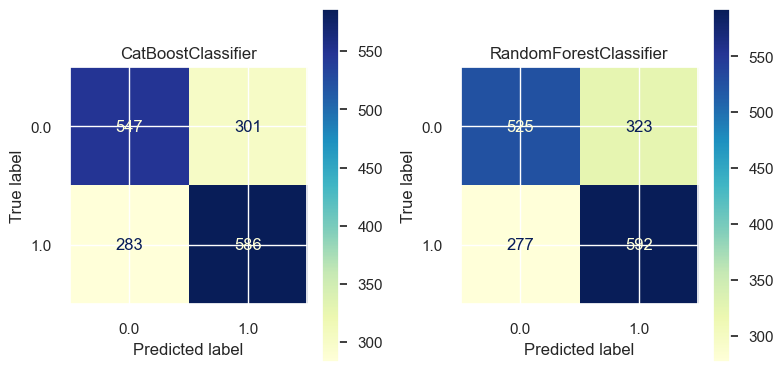

In [117]:

# test models with reweighted data
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 4))

for cls, ax in zip(classifiers, axes.flatten()):
    dataset = RW_train
    cls.fit(dataset.features, dataset.labels.ravel(), sample_weight = dataset.instance_weights)
    
    plot_confusion_matrix(cls, 
                          X_test, 
                          y_test, 
                          ax=ax, 
                          cmap='YlGnBu')
    ax.title.set_text(type(cls).__name__)

plt.tight_layout()
plt.show()

In [118]:

for cls in classifiers:
  cls.fit(dataset.features, dataset.labels.ravel(), sample_weight = w_train)
  y_pred = cls.predict(X_test)
  
  print(f'{cls}: {chr(10)} {classification_report(y_test, y_pred)}')

<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
               precision    recall  f1-score   support

         0.0       0.66      0.65      0.65       848
         1.0       0.66      0.67      0.67       869

    accuracy                           0.66      1717
   macro avg       0.66      0.66      0.66      1717
weighted avg       0.66      0.66      0.66      1717

RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43): 
               precision    recall  f1-score   support

         0.0       0.65      0.62      0.64       848
         1.0       0.65      0.68      0.66       869

    accuracy                           0.65      1717
   macro avg       0.65      0.65      0.65      1717
weighted avg       0.65      0.65      0.65      1717

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
     

In [119]:
# define test 
ds_test_pred = ds_test.copy(deepcopy=True)

In [120]:
for cls in classifiers:
    dataset = RW_train
    cls.fit(dataset.features, dataset.labels.ravel(), sample_weight=dataset.instance_weights)
    y_pred = cls.predict(X_test)

    # scores on test set
    ds_test_pred.scores = cls.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    y_train_pred = cls.predict(X_train)
    test_preds = (y_pred >= np.mean(y_train)) * 1

    models_dict = {"mitigated_pre-processing": (test_preds, y_pred)}

    print(f'Race:{chr(10)}{cls}: {chr(10)} {get_metrics_df(models_dict, y_test, race)} {chr(10)}')  # change age<> gender
    print(f'Race:{chr(10)}{cls}: {chr(10)} {metric_frame(race)} {chr(10)}')  # change age<> gender

    mf1 = MetricFrame(metrics=metrics,
                      y_true=y_test,
                      y_pred=y_pred,
                      sensitive_features=race)

    # The disaggregated metrics are stored in a pandas Series mf1.by_group:
    print(f"{cls}:\n {mf1.by_group}\n")
    print(f"{cls} difference:\n {mf1.difference(method='between_groups')}\n")

    # Calculate Equal Opportunity Differences
    tpr_race1 = metric_frame(race)["TPR"][1]  # TPR for race 1
    tpr_race2 = metric_frame(race)["TPR"][2]  # TPR for race 2
    tpr_race3 = metric_frame(race)["TPR"][3]  # TPR for race 3

    eod_race1_and_2 = tpr_race2 - tpr_race1
    eod_race3_and_2 = tpr_race2 - tpr_race3

    print(f"Equal Opportunity Difference between Races 1 and 2: {eod_race1_and_2}")
    print(f"Equal Opportunity Difference between Races 3 and 2: {eod_race3_and_2}")


Race:
<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
                                mitigated_pre-processing
Equalized_odds_difference                           0.5
False negative rate difference                 0.098358
Balanced error rate difference                 0.261364
Demographic parity difference                  0.164021
  ------                                               
Overall AUC                                    0.659693
AUC difference                                 0.261364 

Race:
<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
            FPR       FNR       TPR       TNR
race                                        
0     0.361111  0.306034  0.693966  0.638889
1     0.000000  0.250000  0.750000  1.000000
2     0.354430  0.338358  0.661642  0.645570
3     0.250000  0.240000  0.760000  0.750000
4     0.500000  0.272727  0.727273  0.500000 

<catboost.core.CatBoostClassifier object at 0x16971a3a0>:
       accuracy  false positive rate  false

### metrics are way lower than the top icd9 codes preprocessing, even though the bias is mitigated, the models here are far less accurate
### XGB shows the most promising

In [121]:

# demographic disparity
# https://github.com/fairlearn/fairlearn/blob/main/notebooks/Mitigating%20Disparities%20in%20Ranking%20from%20Binary%20Data.ipynb

from IPython.display import display, HTML
import matplotlib.pyplot as plt
from scipy.stats import cumfreq

def compare_cdfs(data, A, num_bins=100):
    cdfs = {}
    assert len(np.unique(A)) == 2 
    
    limits = ( min(data), max(data) )
    s = 0.5 * (limits[1] - limits[0]) / (num_bins - 1)
    limits = ( limits[0]-s, limits[1] + s)
    
    for a in np.unique(A):
        subset = data[A==a]
        
        cdfs[a] = cumfreq(subset, numbins=num_bins, defaultreallimits=limits)
        
    lower_limits = [v.lowerlimit for _, v in cdfs.items()]
    bin_sizes = [v.binsize for _,v in cdfs.items()]
    actual_num_bins = [v.cumcount.size for _,v in cdfs.items()]
    
    assert len(np.unique(lower_limits)) == 1
    assert len(np.unique(bin_sizes)) == 1
    assert np.all([num_bins==v.cumcount.size for _,v in cdfs.items()])
    
    xs = lower_limits[0] + np.linspace(0, bin_sizes[0]*num_bins, num_bins)
    
    disparities = np.zeros(num_bins)
    for i in range(num_bins):
        cdf_values = np.clip([v.cumcount[i]/len(data[A==k]) for k,v in cdfs.items()],0,1)
        disparities[i] = max(cdf_values)-min(cdf_values)  
    
    return xs, cdfs, disparities
    
    
def plot_and_compare_cdfs(data, A, num_bins=100, loc='best', title=''):
    xs, cdfs, disparities = compare_cdfs(data, A, num_bins)
    
    for k, v in cdfs.items():
        plt.plot(xs, v.cumcount/len(data[A==k]), label=f"Race {k}")

    assert disparities.argmax().size == 1
    d_idx = disparities.argmax()

    xs_line = [xs[d_idx], xs[d_idx]]
    counts = [v.cumcount[d_idx]/len(data[A==k]) for k, v in cdfs.items()]
    ys_line = [min(counts), max(counts)]

    plt.plot(xs_line, ys_line, 'o--')
    disparity_label = f"Max Disparity = {disparities[d_idx]:.3f}\nAt {xs[d_idx]:0.3f}"
    plt.text(xs[d_idx], 1, disparity_label, ha="right", va="top")

    plt.title(title)  # Add a title to the plot
    plt.ylabel("Cumulative Frequency")
    plt.legend(loc=loc)
    plt.show()

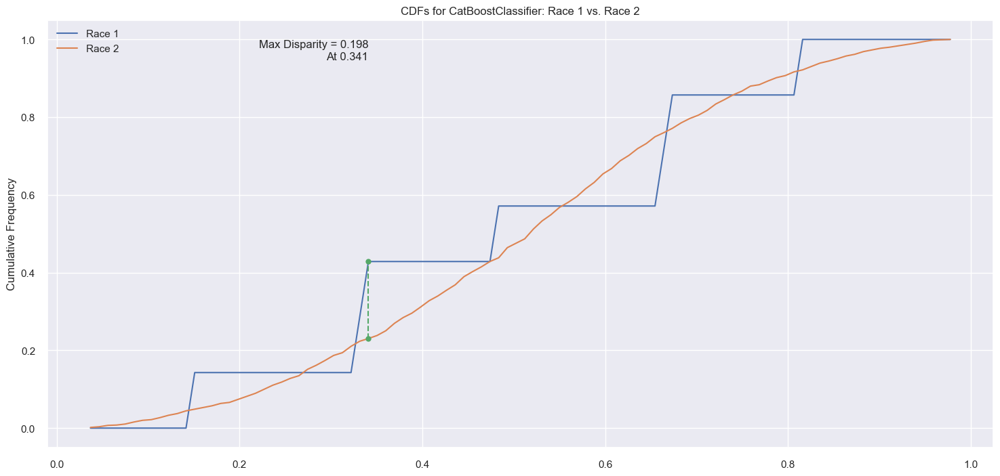

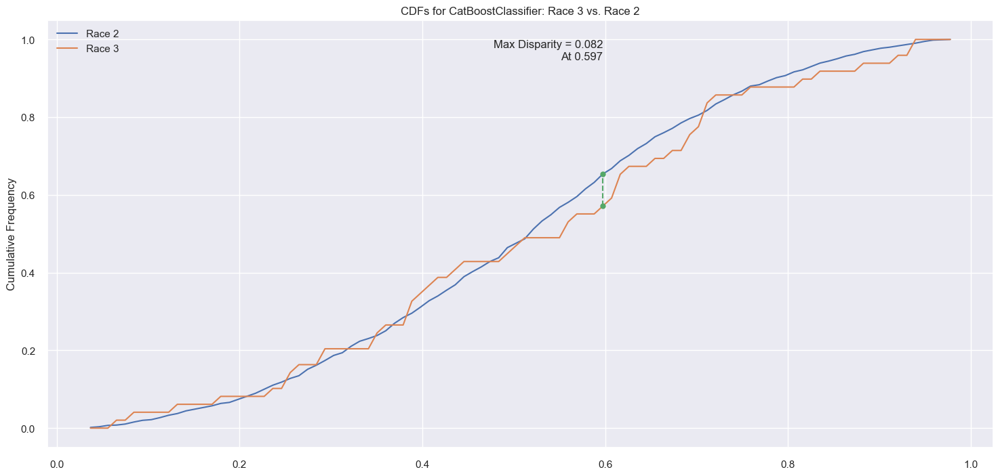

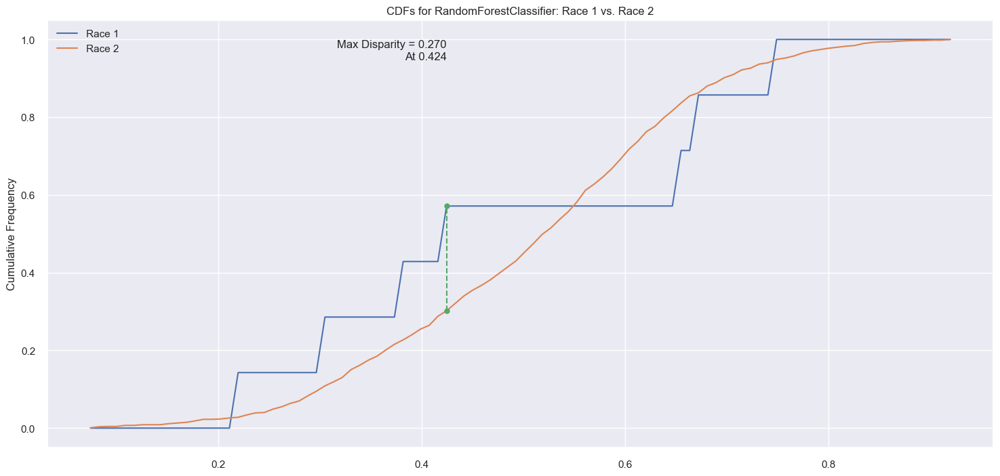

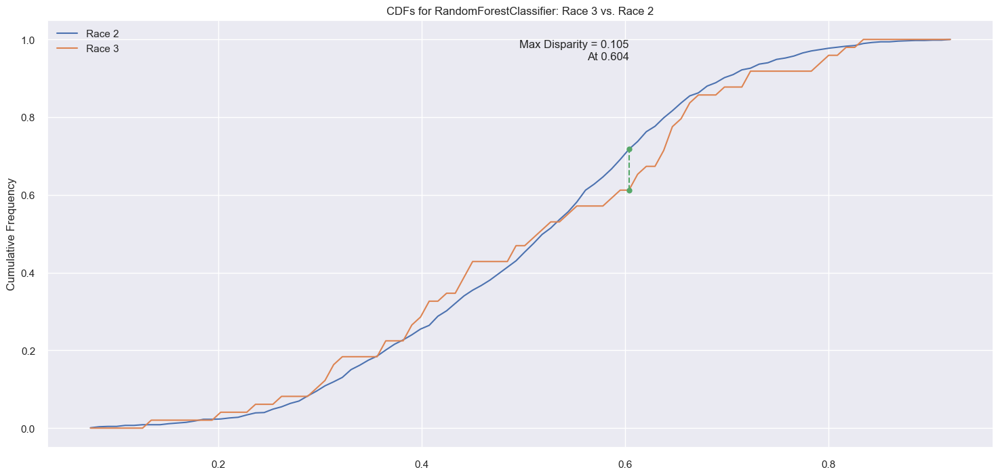

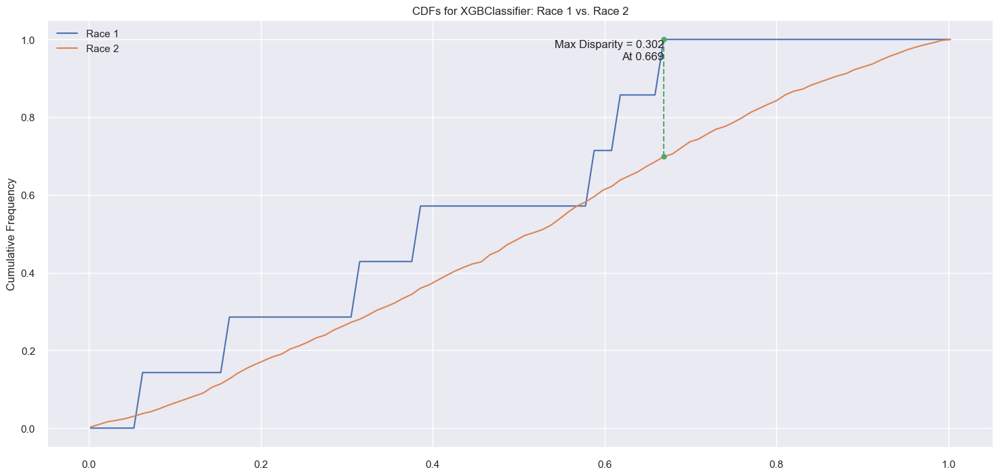

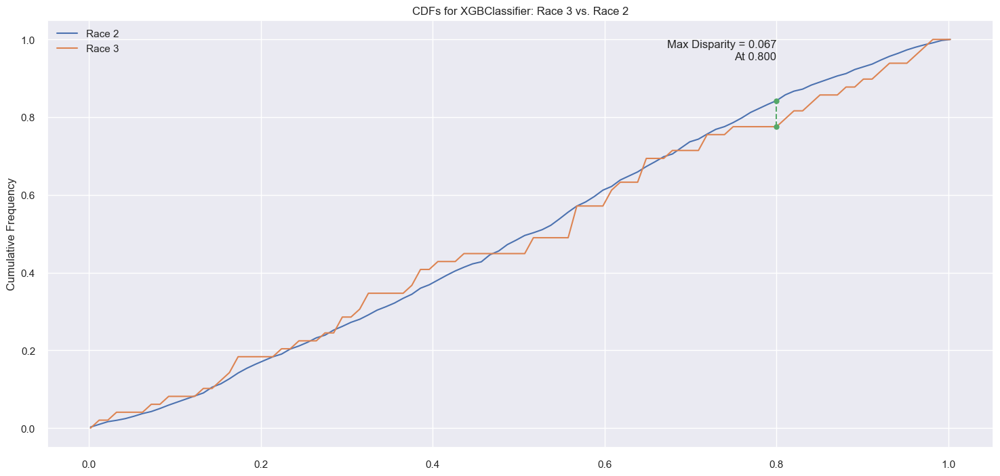

In [122]:
%matplotlib inline

# Define two binary sensitive attributes for the comparisons
compare_race_1_to_2 = (race == 1) | (race == 2)
compare_race_3_to_2 = (race == 3) | (race == 2)

for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # scores on test set
    y_pred_proba = model.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    test_preds = (y_pred_proba >= np.mean(y_train)) * 1

    display(HTML(''))
    plot_and_compare_cdfs(
        y_pred_proba[compare_race_1_to_2], 
        race[compare_race_1_to_2],
        title=f"CDFs for {type(model).__name__}: Race 1 vs. Race 2"
    )
    display(HTML(''))
    
    display(HTML(''))
    plot_and_compare_cdfs(
        y_pred_proba[compare_race_3_to_2], 
        race[compare_race_3_to_2],
        title=f"CDFs for {type(model).__name__}: Race 3 vs. Race 2"
    )
    display(HTML(''))

In [123]:
rf.fit(X_train, y_train, sample_weight=w_train)


RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43)

In [124]:
X_test = pd.DataFrame(X_test, columns=ds_train.feature_names)
X_train = pd.DataFrame(X_train, columns=ds_train.feature_names)


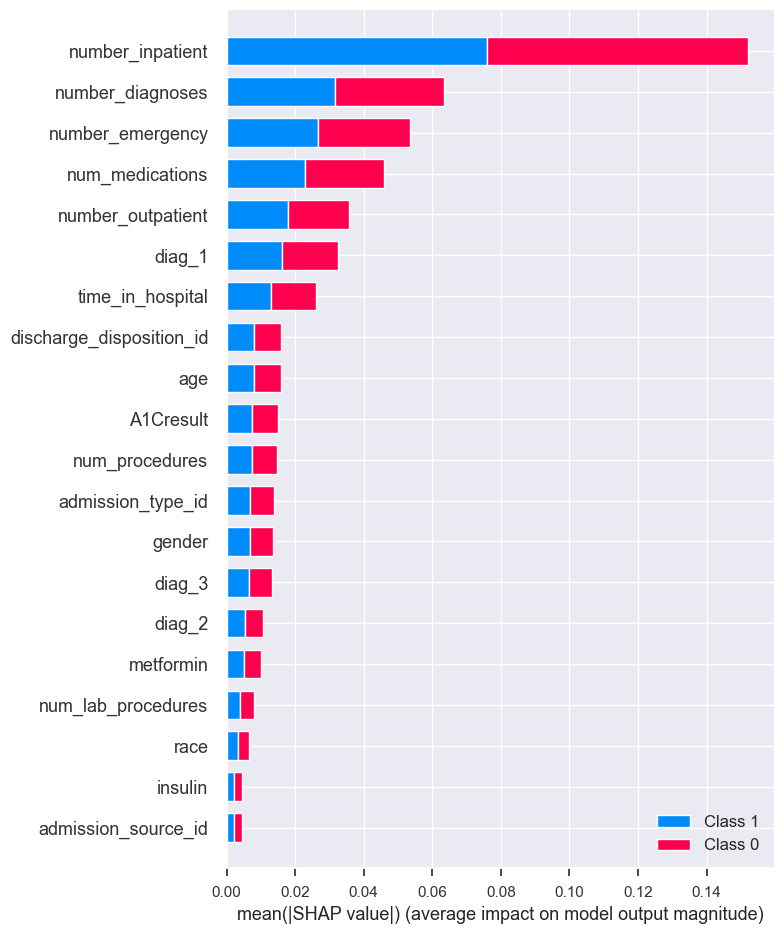

In [125]:
import shap

# Create a SHAP Tree Explainer for the Random Forest model
explainer = shap.TreeExplainer(rf)

# Calculate SHAP values for the test set
shap_values = explainer.shap_values(X_test)

# Visualize the first prediction's explanation (as an example)
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][0], X_test.iloc[0])

# Summary plot
shap.summary_plot(shap_values, X_test)


In [126]:
X_test

,num_lab_procedures,num_medications,diag_2,diag_3,diag_1,time_in_hospital,age,discharge_disposition_id,number_inpatient,number_diagnoses,...,race,number_outpatient,A1Cresult,gender,metformin,glipizide,glyburide,change,number_emergency,diabetesMed
0,51.0,11.0,129.0,59.0,26.0,2.0,6.0,0.0,1.0,7.0,...,1.0,1.0,2.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0
1,38.0,18.0,151.0,142.0,25.0,4.0,8.0,17.0,0.0,6.0,...,0.0,0.0,2.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0
2,1.0,16.0,286.0,171.0,25.0,3.0,7.0,15.0,1.0,4.0,...,1.0,0.0,2.0,1.0,1.0,1.0,2.0,1.0,0.0,1.0
3,37.0,8.0,59.0,68.0,5.0,1.0,2.0,0.0,3.0,3.0,...,0.0,0.0,2.0,0.0,1.0,1.0,1.0,1.0,3.0,1.0
4,74.0,16.0,179.0,241.0,6.0,6.0,6.0,2.0,0.0,8.0,...,1.0,5.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1712,81.0,41.0,129.0,304.0,17.0,10.0,3.0,0.0,0.0,7.0,...,0.0,0.0,2.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0
1713,39.0,24.0,129.0,360.0,16.0,8.0,6.0,2.0,0.0,8.0,...,0.0,0.0,2.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0
1714,38.0,27.0,151.0,161.0,25.0,10.0,8.0,17.0,2.0,5.0,...,0.0,0.0,2.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0
1715,35.0,20.0,286.0,142.0,25.0,8.0,6.0,5.0,1.0,4.0,...,0.0,0.0,2.0,0.0,2.0,1.0,1.0,0.0,0.0,1.0


In [127]:
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier

# Assuming 'rf' is your RandomForestClassifier instance
clf_rf = Pipeline(steps=[('classifier', rf)])

# Fit the pipeline with your resampled dataset
# Note how the `sample_weight` parameter is passed
clf_rf.fit(X_train, y_train, classifier__sample_weight=w_train)


Pipeline(steps=[('classifier',
                 RandomForestClassifier(max_depth=9, n_estimators=450,
                                        random_state=43))])

In [128]:
import shap

# Initialize the SHAP explainer with your Random Forest model
explainer = shap.TreeExplainer(clf_rf.named_steps['classifier'])

# Calculate SHAP values for your test set or any new dataset
# Assuming X_test is your test dataset
shap_values = explainer.shap_values(X_test)

# Visualize the first prediction's explanation
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][0], X_test.iloc[50])

In [129]:
import lime
import lime.lime_tabular

# Create a LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=X_train.columns,
    class_names=['Not Readmitted', 'Readmitted'], # Adjust class names as necessary
    verbose=True, mode='classification'
)

# Explain the prediction on the first instance
exp = explainer.explain_instance(X_train.iloc[1000], clf_rf.predict_proba)
exp.show_in_notebook(show_table=True)


Intercept 0.7325575717827458
Prediction_local [0.43766217]
Right: 0.37446364382109626


In [130]:
clf_catboost = Pipeline(steps=[('classifier', catboost)])
clf_xgb = Pipeline(steps=[('classifier', xgb)])

clf_catboost.fit(X_train, y_train, classifier__sample_weight=w_train)
clf_xgb.fit(X_train, y_train, classifier__sample_weight=w_train)

Pipeline(steps=[('classifier',
                 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=0, gpu_id=-1,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constraints='',
                               learning_rate=0.300000012, max_bin=256,
                               max_cat_threshold=64, max_cat_to_onehot=4,
                               max_delta_step=0, max_depth=6, max_leaves=0,
                               min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=100,
                               n_jobs=0, num_parallel_tree=1, predictor='auto',
                               random_state=0, ...))])

In [131]:
import dalex as dx

exp_catboost = dx.Explainer(clf_catboost, X_train, y_train, verbose=False)
exp_rf = dx.Explainer(clf_rf, X_train, y_train, verbose=False)
exp_xgb = dx.Explainer(clf_xgb, X_train, y_train, verbose=False)

In [132]:
# Create a 'protected' array-like based on the 'race' column
protected = np.where(X_train['race'] == 0.0, 'protected', np.where(X_train['race'] == 1.0, 'privileged', 'other'))
privileged = 'privileged'

In [133]:
fobject_catboost = exp_catboost.model_fairness(protected=protected, privileged=privileged)
fobject_rf = exp_rf.model_fairness(protected=protected, privileged=privileged)
fobject_xgb = exp_xgb.model_fairness(protected=protected, privileged=privileged)

# Conduct fairness checks with a default epsilon of 0.8
print(fobject_catboost.fairness_check(epsilon=0.8))
print(fobject_rf.fairness_check(epsilon=0.8))
print(fobject_xgb.fairness_check(epsilon=0.8))

Bias detected in 1 metric: FPR

Conclusion: your model cannot be called fair because 1 criterion exceeded acceptable limits set by epsilon.
It does not mean that your model is unfair but it cannot be automatically approved based on these metrics.

Ratios of metrics, based on 'privileged'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
               TPR       ACC       PPV       FPR       STP
protected  0.90887  0.991326  0.991443  0.731132  0.803704
None
Bias detected in 1 metric: FPR

Conclusion: your model cannot be called fair because 1 criterion exceeded acceptable limits set by epsilon.
It does not mean that your model is unfair but it cannot be automatically approved based on these metrics.

Ratios of metrics, based on 'privileged'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
                TPR       ACC      PPV       FPR       STP
protected  0.915404  0.994805  0.97954  0.772549  0.819521
None
Bi

In [134]:
fobject_rf.plot(objects=[fobject_catboost, fobject_xgb])


In [135]:
fobject_rf.plot(objects=[fobject_catboost, fobject_xgb], type = "metric_scores")

In [136]:
fobject_rf.plot(objects=[fobject_catboost, fobject_xgb], type = "radar")

In [137]:
fobject_rf.plot(objects=[fobject_catboost, fobject_xgb], type = "heatmap")

In [138]:
fobject_rf.plot(objects=[fobject_catboost, fobject_xgb], type = "stacked")

In [139]:
fobject_rf.plot(objects=[fobject_catboost, fobject_xgb], type = "performance_and_fairness")

# UNAWARE MODEL

In [140]:

# set test & train data & defining age as sensitive attribute - UNAWARE

X = diabetes_diag_df_.drop(columns=['race','readmitted_2_encoded'])
y = diabetes_diag_df_['readmitted_2_encoded']

A = diabetes_diag_df_['race']


# for fairnes measures (inlc. A for group classification, drop age to make it unaware to other senstive attributes (fairnes through unawarenes)) - AGE 
X_train, X_test, y_train, y_test, A_train, A_test = train_test_split(
    X, 
    y, 
    A, 

    test_size = 0.20, 
    random_state=42)


from sklearn.metrics import accuracy_score, confusion_matrix

def demographic_parity(y_true, y_pred):
    return abs(sum(y_pred == 1) / len(y_pred) - sum(y_true == 1) / len(y_true))

def equal_opportunity(y_true, y_pred):
    tpr_pred = sum((y_true == 1) & (y_pred == 1)) / sum(y_true == 1)
    tpr_true = sum((y_true == 1) & (y_pred == 1)) / sum(y_true == 1)
    return abs(tpr_pred - tpr_true)

def statistical_parity(y_true, y_pred):
    return abs(sum(y_pred == 1) / len(y_pred) - sum(y_true == 1) / len(y_true))

for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Calculate fairness metrics
    dp = demographic_parity(y_test, y_pred)
    eo = equal_opportunity(y_test, y_pred)
    sp = statistical_parity(y_test, y_pred)
    
    print(f"Fairness Metrics for {type(model).__name__}:")
    print(f"Demographic Parity: {dp:.4f}")
    print(f"Equal Opportunity: {eo:.4f}")
    print(f"Statistical Parity: {sp:.4f}")
    print()

Fairness Metrics for CatBoostClassifier:
Demographic Parity: 0.0280
Equal Opportunity: 0.0000
Statistical Parity: 0.0280

Fairness Metrics for RandomForestClassifier:
Demographic Parity: 0.0355
Equal Opportunity: 0.0000
Statistical Parity: 0.0355

Fairness Metrics for XGBClassifier:
Demographic Parity: 0.0215
Equal Opportunity: 0.0000
Statistical Parity: 0.0215



In [141]:
from sklearn.model_selection import cross_val_predict, StratifiedKFold
from sklearn.metrics import classification_report, roc_auc_score



classifier_names = ["CatBoostClassifier", "RandomForestClassifier", "XGBoostClassifier"]

# Define the number of splits for cross-validation
n_splits = 4

# Loop over classifiers
for model, classifier_name in zip(classifiers, classifier_names):
    print(f"Evaluating {classifier_name}:")
    
    # Initialize lists to store classification reports and AUC scores
    classification_reports = []
    auc_scores = []
    
    # Perform cross-validation
    for train_index, test_index in StratifiedKFold(n_splits=n_splits).split(X_test, y_test):
        X_train_cv, X_test_cv = X_test.iloc[train_index], X_test.iloc[test_index]
        y_train_cv, y_test_cv = y_test.iloc[train_index], y_test.iloc[test_index]

        # Fit the model on the training data
        model.fit(X_train_cv, y_train_cv)

        # Make predictions on the test data
        y_pred_cv = model.predict(X_test_cv)

        # Predict probabilities for the 'Readmitted' class
        y_probs_cv = model.predict_proba(X_test_cv)[:, 1]

        # Compute the ROC-AUC score
        auc_cv = roc_auc_score(y_test_cv, y_probs_cv)
        auc_scores.append(auc_cv)

        # Generate and store the classification report
        report_cv = classification_report(y_test_cv, y_pred_cv, target_names=['Not Readmitted', 'Readmitted'], output_dict=True)
        classification_reports.append(report_cv)

    # Calculate the average AUC score across cross-validation folds
    avg_auc_score = sum(auc_scores) / len(auc_scores)
    
    # Calculate the average classification report across cross-validation folds
    avg_classification_report = {}
    for label in ['Not Readmitted', 'Readmitted']:
        avg_classification_report[label] = {
            'precision': sum(report[label]['precision'] for report in classification_reports) / len(classification_reports),
            'recall': sum(report[label]['recall'] for report in classification_reports) / len(classification_reports),
            'f1-score': sum(report[label]['f1-score'] for report in classification_reports) / len(classification_reports),
            'support': int(sum(report[label]['support'] for report in classification_reports) / len(classification_reports))
        }

    # Format and print the results
    print("Average Classification Report Unaware of Race:")
    for label in avg_classification_report:
        print(f"{label}:")
        for metric in avg_classification_report[label]:
            print(f"{metric}: {avg_classification_report[label][metric]:.2f}")
        print()
    print(f"Average AUC Score: {avg_auc_score:.2f}")
    print("\n")


Evaluating CatBoostClassifier:
Average Classification Report Unaware of Race:
Not Readmitted:
precision: 0.62
recall: 0.60
f1-score: 0.61
support: 209.00

Readmitted:
precision: 0.63
recall: 0.65
f1-score: 0.64
support: 220.00

Average AUC Score: 0.70


Evaluating RandomForestClassifier:
Average Classification Report Unaware of Race:
Not Readmitted:
precision: 0.64
recall: 0.63
f1-score: 0.63
support: 209.00

Readmitted:
precision: 0.65
recall: 0.66
f1-score: 0.66
support: 220.00

Average AUC Score: 0.71


Evaluating XGBoostClassifier:
Average Classification Report Unaware of Race:
Not Readmitted:
precision: 0.60
recall: 0.59
f1-score: 0.59
support: 209.00

Readmitted:
precision: 0.62
recall: 0.62
f1-score: 0.62
support: 220.00

Average AUC Score: 0.66




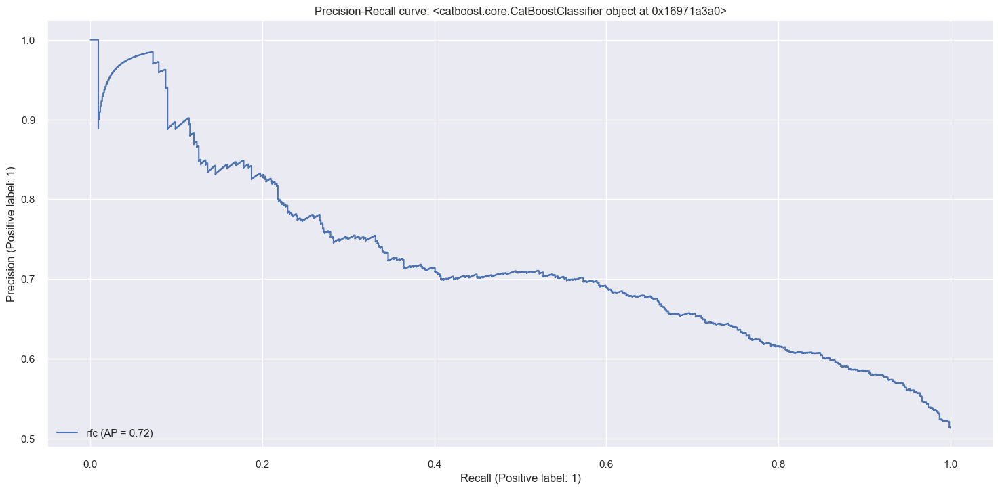

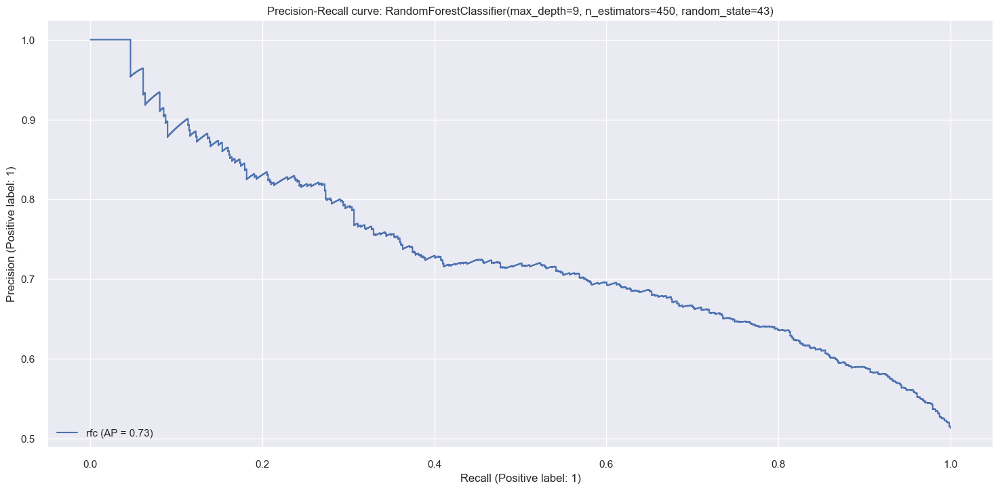

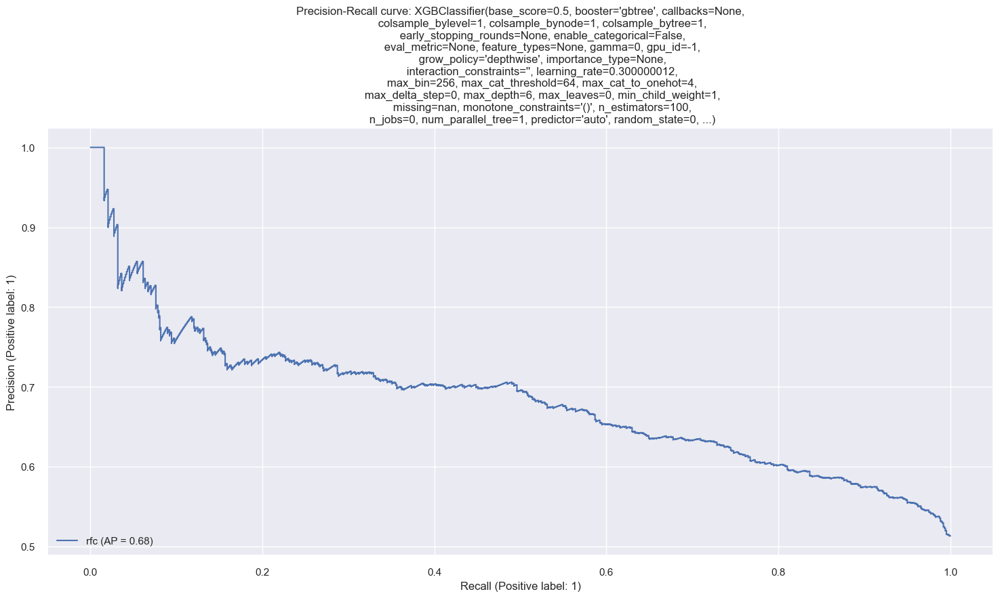

In [142]:
for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)
  display = PrecisionRecallDisplay.from_estimator(model, X_test, y_test, name="rfc")
  _ = display.ax_.set_title(f'Precision-Recall curve: {model}')  

In [143]:
# define sensitive attributes
race =  A_test


for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # scores on test set
  y_pred = model.predict_proba(X_test)[:, 1]

  # predictions (0 or 1) on test set
  test_preds = (y_pred >= np.mean(y_train)) * 1

  print(f'Race-Model is Unaware:{chr(10)}{model}: {chr(10)} {metric_frame (race)} {chr(10)}')

Race-Model is Unaware:
<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
            FPR       FNR       TPR       TNR
race                                        
0     0.300781  0.368421  0.631579  0.699219
1     0.333333  0.000000  1.000000  0.666667
2     0.382022  0.323052  0.676948  0.617978
3     0.357143  0.190476  0.809524  0.642857
4     0.500000  0.400000  0.600000  0.500000 

Race-Model is Unaware:
RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43): 
            FPR       FNR       TPR       TNR
race                                        
0     0.292969  0.350877  0.649123  0.707031
1     0.333333  0.000000  1.000000  0.666667
2     0.387640  0.301948  0.698052  0.612360
3     0.357143  0.238095  0.761905  0.642857
4     0.500000  0.466667  0.533333  0.500000 

Race-Model is Unaware:
XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stop

In [144]:
# Define sensitive attributes
race = A_test

# Initialize lists to store the differences
difference_race1_and_2 = []
difference_race3_and_2 = []

# Metrics 
for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # scores on test set
    y_pred = model.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    test_preds = (y_pred >= np.mean(y_train)) * 1

    models_dict = {"Unaware": (test_preds, y_pred)}

    # Calculate the TPR for each race group
    tpr_race1 = metric_frame(race)["TPR"][1]  # TPR for race 1
    tpr_race2 = metric_frame(race)["TPR"][2]  # TPR for race 2
    tpr_race3 = metric_frame(race)["TPR"][3]  # TPR for race 5

    # Calculate and store the differences
    diff1_and_2 = tpr_race2 - tpr_race1
    diff3_and_2 = tpr_race2 - tpr_race3

    difference_race1_and_2.append(diff1_and_2)
    difference_race3_and_2.append(diff3_and_2)

    print(f'Race:{chr(10)}{model}: {chr(10)} {get_metrics_df(models_dict, y_test, race)} {chr(10)}') 

    # Calculate Equal Opportunity Differences for the current classifier
    eod_race1_and_2 = diff1_and_2
    eod_race3_and_2 = diff3_and_2

    print(f'Equal Opportunity Difference between Races 1 and 2: {eod_race1_and_2}')
    print(f'Equal Opportunity Difference between Races 3 and 2: {eod_race3_and_2}')



Race:
<catboost.core.CatBoostClassifier object at 0x16971a3a0>: 
                                  Unaware
Equalized_odds_difference            0.4
False negative rate difference       0.4
Balanced error rate difference  0.283333
Demographic parity difference   0.126984
  ------                                
Overall AUC                     0.712863
AUC difference                  0.388889 

Equal Opportunity Difference between Races 1 and 2: -0.32305194805194803
Equal Opportunity Difference between Races 3 and 2: -0.13257575757575757
Race:
RandomForestClassifier(max_depth=9, n_estimators=450, random_state=43): 
                                  Unaware
Equalized_odds_difference       0.466667
False negative rate difference  0.466667
Balanced error rate difference  0.316667
Demographic parity difference   0.125342
  ------                                
Overall AUC                     0.724603
AUC difference                  0.438889 

Equal Opportunity Difference between Races 1 and

In [145]:

# demographic disparity
# https://github.com/fairlearn/fairlearn/blob/main/notebooks/Mitigating%20Disparities%20in%20Ranking%20from%20Binary%20Data.ipynb

from IPython.display import display, HTML
import matplotlib.pyplot as plt
from scipy.stats import cumfreq

def compare_cdfs(data, A, num_bins=100):
    cdfs = {}
    assert len(np.unique(A)) == 2 
    
    limits = ( min(data), max(data) )
    s = 0.5 * (limits[1] - limits[0]) / (num_bins - 1)
    limits = ( limits[0]-s, limits[1] + s)
    
    for a in np.unique(A):
        subset = data[A==a]
        
        cdfs[a] = cumfreq(subset, numbins=num_bins, defaultreallimits=limits)
        
    lower_limits = [v.lowerlimit for _, v in cdfs.items()]
    bin_sizes = [v.binsize for _,v in cdfs.items()]
    actual_num_bins = [v.cumcount.size for _,v in cdfs.items()]
    
    assert len(np.unique(lower_limits)) == 1
    assert len(np.unique(bin_sizes)) == 1
    assert np.all([num_bins==v.cumcount.size for _,v in cdfs.items()])
    
    xs = lower_limits[0] + np.linspace(0, bin_sizes[0]*num_bins, num_bins)
    
    disparities = np.zeros(num_bins)
    for i in range(num_bins):
        cdf_values = np.clip([v.cumcount[i]/len(data[A==k]) for k,v in cdfs.items()],0,1)
        disparities[i] = max(cdf_values)-min(cdf_values)  
    
    return xs, cdfs, disparities
    
    
def plot_and_compare_cdfs(data, A, num_bins=100, loc='best', title=''):
    xs, cdfs, disparities = compare_cdfs(data, A, num_bins)
    
    for k, v in cdfs.items():
        plt.plot(xs, v.cumcount/len(data[A==k]), label=f"Race {k}")

    assert disparities.argmax().size == 1
    d_idx = disparities.argmax()

    xs_line = [xs[d_idx], xs[d_idx]]
    counts = [v.cumcount[d_idx]/len(data[A==k]) for k, v in cdfs.items()]
    ys_line = [min(counts), max(counts)]

    plt.plot(xs_line, ys_line, 'o--')
    disparity_label = f"Max Disparity = {disparities[d_idx]:.3f}\nAt {xs[d_idx]:0.3f}"
    plt.text(xs[d_idx], 1, disparity_label, ha="right", va="top")

    plt.title(title)  # Add a title to the plot
    plt.ylabel("Cumulative Frequency")
    plt.legend(loc=loc)
    plt.show()

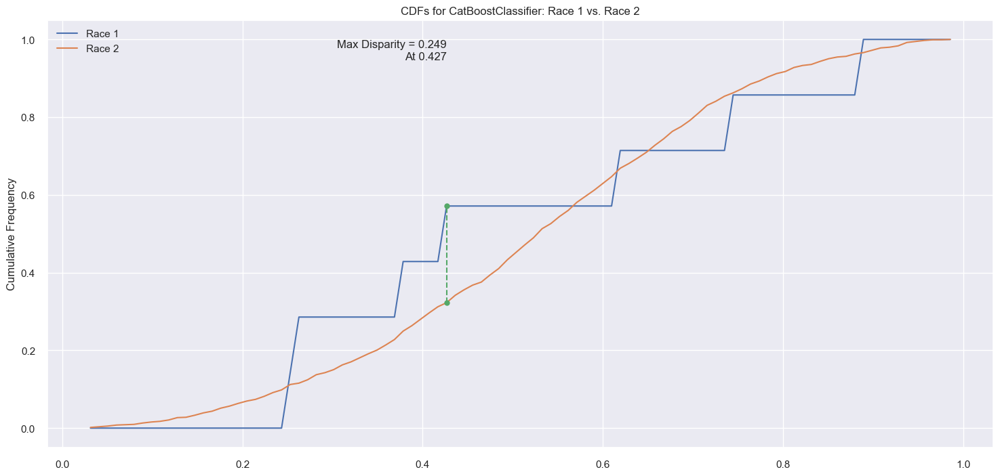

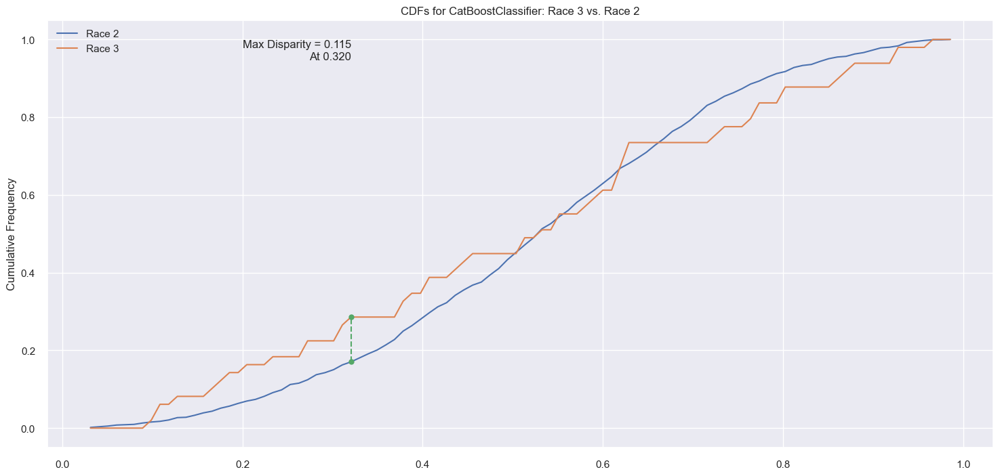

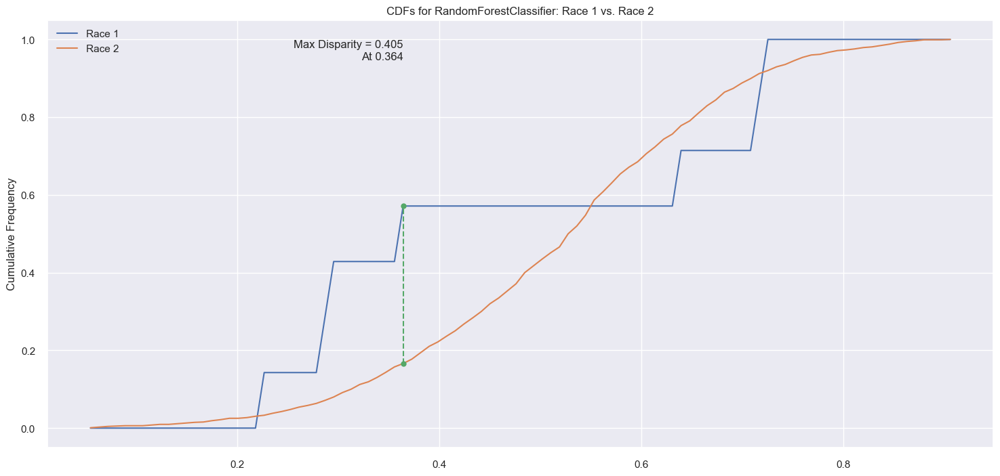

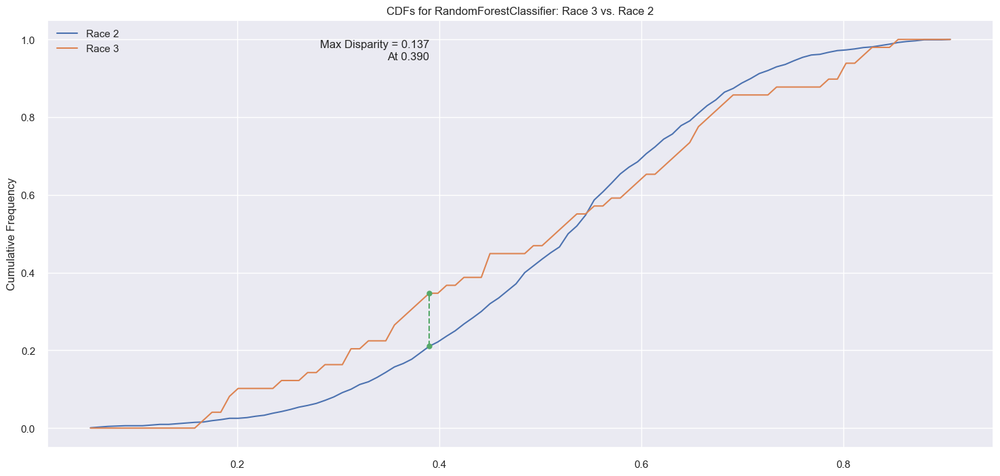

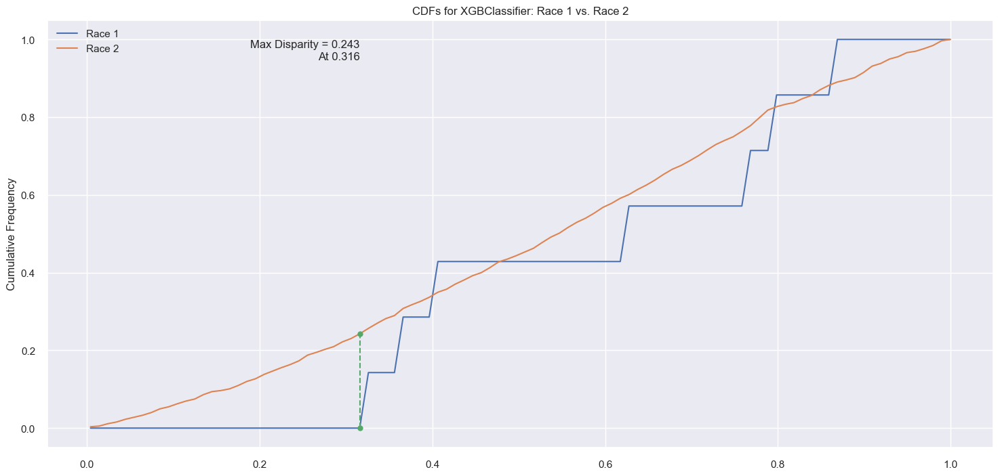

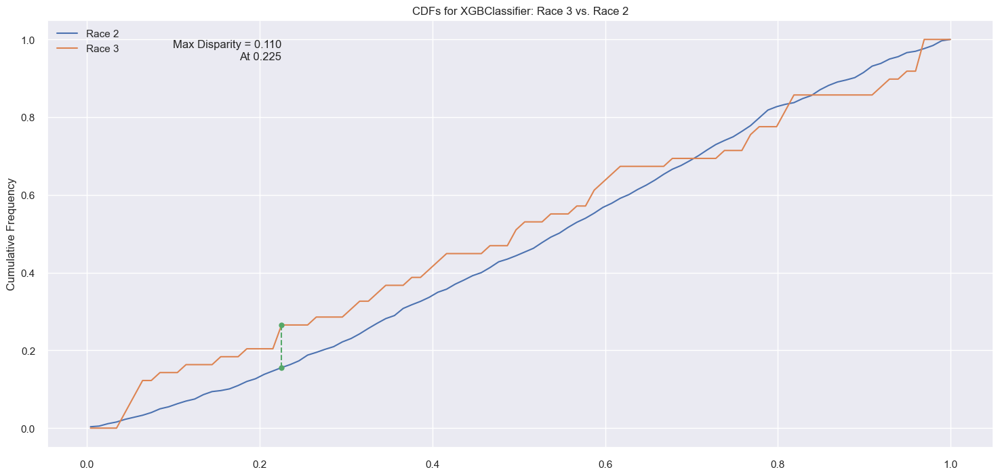

In [146]:
# Define two binary sensitive attributes for the comparisons
compare_race_1_to_2 = (race == 1) | (race == 2)
compare_race_3_to_2 = (race == 3) | (race == 2)

for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # scores on test set
    y_pred_proba = model.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    test_preds = (y_pred_proba >= np.mean(y_train)) * 1

    display(HTML(''))
    plot_and_compare_cdfs(
        y_pred_proba[compare_race_1_to_2], 
        race[compare_race_1_to_2],
        title=f"CDFs for {type(model).__name__}: Race 1 vs. Race 2"
    )
    display(HTML(''))
    
    display(HTML(''))
    plot_and_compare_cdfs(
        y_pred_proba[compare_race_3_to_2], 
        race[compare_race_3_to_2],
        title=f"CDFs for {type(model).__name__}: Race 3 vs. Race 2"
    )
    display(HTML(''))

NEXT STEPS:
 UNDERSTAND MY FINDINGS AND PUT THEM ORGANISED IN A LIST 
 ITS : ONLY IMPORTANT ICD 9 CODES PREPROCESSED DATASET AND AWARE MODEL VS UNAWARE MODEL (RACE)
       NOT GROUPED UP ICD 9 CODES PREPROCESSED DATASET, WAY MORE SUBJECTS TO GET TRAINED BY, AWARE VS UNAWARE 
       
       
       NOW I NEED TO CREATE A MORE REPRESENTATIVE DATASET EG REMOVE A LARGE PERCENT OF CAUCASIANS AND TRAIN CLASSIFIERS WITH THE NEW DATASET 